<a href="https://colab.research.google.com/github/yelmokht/nuclei-segmentation/blob/main/nuclei.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
ROOT_PATH = '/content/'
DRIVE_PATH = ROOT_PATH + "drive/MyDrive/Colab Notebooks/"
SOURCE_PATH = DRIVE_PATH + 'data-science-bowl-2018.zip'
UNZIPPED_PATH = ROOT_PATH + 'unzipped/'
DESTINATION_PATH = DATA_PATH = ROOT_PATH + 'dsb_2018/'
TRAIN_PATH = DATA_PATH + 'stage1_train/'
TEST_1_PATH = DATA_PATH + 'stage1_test/'
TEST_2_PATH = DATA_PATH + 'stage2_test/'
STAGE_1_PATH = DATA_PATH + 'stage1_test/'
STAGE_2_PATH = DATA_PATH + 'stage2_test/'
STAGE_1_SOLUTION_PATH = DATA_PATH + 'stage1_solution/stage1_solution.csv'
STAGE_2_SOLUTION_PATH = DATA_PATH + 'stage2_solution/stage2_solution.csv'
IMAGE_HEIGHT = MASK_HEIGHT = 256
IMAGE_WIDTH = MASK_WIDTH = 256
IMAGE_NUM_CHANNELS = 3
MASK_NUM_CHANNELS = 1
IMAGE_SHAPE = (IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_NUM_CHANNELS)
MASK_SHAPE = (MASK_HEIGHT, MASK_WIDTH, MASK_NUM_CHANNELS)
SEED = 42
BATCH_SIZE = 32
EPOCHS = 100
PATH = f'/content/drive/MyDrive/Colab Notebooks/r_100.keras'
HISTORY_PATH = f'/content/drive/MyDrive/Colab Notebooks/final_100_2_history.csv'
SUBMISSION_PATH = DRIVE_PATH + 'submission.csv'
SOLUTION_PATH = DRIVE_PATH + 'solution.csv'

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from ipywidgets import interact, FloatSlider, IntSlider
from skimage.filters import threshold_otsu, threshold_multiotsu
from skimage import morphology
from skimage import segmentation
from skimage.color import rgb2gray, rgb2hsv
from skimage.filters import sobel,gaussian
from skimage.feature import peak_local_max, corner_peaks
from scipy.ndimage import distance_transform_edt, binary_fill_holes
from skimage.filters.rank import gradient
from skimage.morphology import disk
from skimage.segmentation import watershed, mark_boundaries
from skimage.feature import canny
from skimage.color import rgb2gray
from scipy.ndimage import center_of_mass
from skimage.measure import regionprops
from skimage.filters import unsharp_mask
from skimage.morphology import flood_fill

In [ ]:
import os
import shutil
from zipfile import ZipFile

def unzip_and_structure_data(source_path, unzipped_path, destination_path):
    # Unzip files from source to unzipped
    if not os.path.exists(unzipped_path):
        with ZipFile(source_path, 'r') as zip_ref:
            zip_ref.extractall(unzipped_path)
        print("Files unzipped successfully.")
    else:
        print("Unzipped files already exist.")

    # Structure data from unzipped to destination
    if not os.path.exists(destination_path):
        for root, dirs, files in os.walk(unzipped_path):
            for filename in files:
                if filename.endswith(".zip"):
                    zip_file_path = os.path.join(root, filename)
                    output_folder = os.path.join(destination_path, os.path.splitext(filename)[0])
                    with ZipFile(zip_file_path, 'r') as zip_ref:
                        zip_ref.extractall(output_folder)
                    print(f"Unzipped {filename} to {output_folder}")
        print("Data files structured successfully.")
    else:
        print("Data files already exist.")

In [ ]:
import numpy as np
import pandas as pd
import os
from skimage.io import imsave
from tqdm.auto import tqdm
import warnings

warnings.filterwarnings('ignore', category=UserWarning)

def rle_decode(rle_list, mask_shape, mask_dtype):
    masks = []
    for j, rle in enumerate(rle_list):
        mask = np.zeros(np.prod(mask_shape), dtype=mask_dtype)
        s = rle.split()
        starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
        starts -= 1
        ends = starts + lengths
        for lo, hi in zip(starts, ends):
            mask[lo:hi] = 255
        masks.append(mask.reshape(mask_shape[::-1]).T)
    return np.array(masks)

def rle_to_masks(csv_path):
    gt_masks = {}
    df = pd.read_csv(csv_path, sep=',')
    image_ids = sorted(list(df['ImageId'].unique()))

    for image_id in image_ids:
        mask_rles = df.loc[df['ImageId'] == image_id]
        rle_list = mask_rles['EncodedPixels']
        heigth, width = pd.unique(mask_rles['Height'])[0], pd.unique(mask_rles['Width'])[0]
        masks = rle_decode(rle_list=rle_list, mask_shape=(heigth, width), mask_dtype=np.uint16)
        gt_masks[image_id] = masks

    return gt_masks


def get_ignored_images(csv_path, destination_path):
    df = pd.read_csv(csv_path)
    ignore_images = df.loc[df['Usage'] == 'Ignored', 'ImageId'].tolist()
    return [os.path.join(destination_path, image_id) for image_id in ignore_images]

def remove_ignored_images_masks(csv_path, destination_path):
    df = pd.read_csv(csv_path)
    ignore_images = df.loc[df['Usage'] == 'Ignored', 'ImageId'].tolist()
    for image_id in ignore_images:
        folder_path = os.path.join(destination_path, image_id)
        if os.path.exists(folder_path):
            shutil.rmtree(folder_path)
        else:
            print(f"Folder '{folder_path}' doesn't exist.")
        df = df[df['ImageId'] != image_id]

    # Save updated DataFrame back to CSV
    df.to_csv(csv_path, index=False)
    print('stage2_solution.csv updated !')
    print('Images and masks of stage 2 updated !')


def save_masks(source_path, destination_path):
    # Load masks
    gt_masks = rle_to_masks(source_path)

    # Iterate over each key in gt_masks (folder IDs)
    for folder_id, masks in tqdm(gt_masks.items()):
        folder_path = os.path.join(destination_path, str(folder_id))
        if not os.path.exists(folder_path):
            raise FileNotFoundError(f"Destination folder '{folder_path}' does not exist.")

        # Create masks folder inside the folder
        masks_folder_path = os.path.join(folder_path, 'masks')
        if not os.path.exists(masks_folder_path):
            os.makedirs(masks_folder_path)  # Create masks folder if it doesn't exist
            # Iterate over each value in gt_masks[key] (list of masks)
            for idx, mask in enumerate(masks):
                # Save mask as an image file in the masks folder
                mask_filename = f'{folder_id}_{idx}.png'
                mask_file_path = os.path.join(masks_folder_path, mask_filename)
                imsave(mask_file_path, mask)

    print('Masks successfully saved !')

def decode_RLE_and_save_masks(STAGE_1_PATH, STAGE_2_PATH, STAGE_1_SOLUTION_PATH, STAGE_2_SOLUTION_PATH):
    save_masks(STAGE_1_SOLUTION_PATH, STAGE_1_PATH)
    save_masks(STAGE_2_SOLUTION_PATH, STAGE_2_PATH)


In [ ]:
from skimage.io import imread
from glob import glob
from tqdm.auto import tqdm
import numpy as np

def read_image(image_path):
    return imread(image_path).astype(np.uint8)

def combine_masks_into_binary_mask(masks):
    num_masks, height, width = masks.shape
    combined_mask = np.zeros((height, width), np.uint8)
    for index in range(0, num_masks):
        combined_mask[masks[index] > 0] = 255
    return combined_mask

def combine_masks(id):
    masks_paths = glob(id + '/masks/*.png')
    masks = np.array([read_image(mask_path) for mask_path in masks_paths])
    return combine_masks_into_binary_mask(masks)

def f(id):
    masks_paths = glob(id + '/masks/*.png')
    masks = np.array([read_image(mask_path) for mask_path in masks_paths])
    markers = []
    for mask in masks:
        mask = resize(mask, (256, 256)).astype(np.float32)
        labeled_mask = label(mask)
        regions = regionprops(labeled_mask)
        for region in regions:
            center_row, center_col = region.centroid
            markers.append([center_row, center_col])
    markers = np.array(markers)
    return markers


def load_data(train_path, test_1_path, test_2_path):
    train_image_paths = sorted(glob(train_path + '*/images/*.png'))
    test_1_image_paths = sorted(glob(test_1_path + '*/images/*.png'))
    test_2_image_paths = sorted(glob(test_2_path + '*/images/*.png'))

    train_ids = [path.rsplit('/', 2)[0] for path in train_image_paths]
    test_1_ids = [path.rsplit('/', 2)[0] for path in test_1_image_paths]
    test_2_ids = [path.rsplit('/', 2)[0] for path in test_2_image_paths]

    train_images = [read_image(image_path) for image_path in tqdm(train_image_paths, desc='Train images')]
    test_1_images = [read_image(image_path) for image_path in tqdm(test_1_image_paths, desc='Test images (stage 1)')]
    test_2_images = [read_image(image_path) for image_path in tqdm(test_2_image_paths, desc='Test images (stage 2)')]

    test_2_shapes = [image.shape for image in tqdm(test_2_images)]

    train_masks = [combine_masks(id) for id in tqdm(train_ids, desc='Train masks')]
    test_1_masks = [combine_masks(id) for id in tqdm(test_1_ids, desc='Test masks (stage 1)')]
    test_2_masks = [combine_masks(id) for id in tqdm(test_2_ids, desc='Test masks (stage 2)')]

    train_images += test_1_images
    train_masks += test_1_masks

    test_1_markers = [f(id) for id in tqdm(test_1_ids, desc='Test masks (stage 1)')]
    test_2_markers = [f(id) for id in tqdm(test_2_ids, desc='Test masks (stage 2)')]

    return train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks, test_1_markers, test_2_markers, test_2_ids, test_2_shapes

In [ ]:
def analyze_data(train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks):
    return None


In [ ]:
from skimage.transform import resize
from skimage.color import rgb2gray

def preprocess_images(images, shape, param=False):
  processed_images = []

  for image in tqdm(images):
    processed_image = None

    if shape[2] == 3:
        if len(image.shape) == 3 and image.shape[2] >= shape[2]:
            processed_image = resize(image[:, :, :shape[2]], (shape[0], shape[1])).astype(np.float32)

        else:
            print(image.shape)
            processed_image = np.repeat(image[:, :, np.newaxis], 3, axis=-1)
            print(processed_image.shape)
            processed_image = resize(processed_image[:, :, :shape[2]], (shape[0], shape[1])).astype(np.float32)

    if shape[2] == 1:
        processed_image = resize(image, (shape[0], shape[1])).astype(np.float32)
        if param == False:
            processed_image = np.expand_dims(processed_image, axis=-1)

    processed_images.append(processed_image)

  return np.array(processed_images).astype(np.float32)

def preprocess_data(train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks):
    train_images = preprocess_images(train_images, IMAGE_SHAPE)
    test_1_images = preprocess_images(test_1_images, IMAGE_SHAPE)
    test_2_images = preprocess_images(test_2_images, IMAGE_SHAPE)
    train_masks = preprocess_images(train_masks, MASK_SHAPE)
    test_1_masks = preprocess_images(test_1_masks, MASK_SHAPE)
    test_2_masks = preprocess_images(test_2_masks, MASK_SHAPE)
    return train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks


In [ ]:
from sklearn.model_selection import train_test_split

def train_val_split(train_images, train_masks, ratio=0.3):
    return train_test_split(train_images, train_masks, test_size=ratio, random_state=0)

In [ ]:
import random
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def generate_augmented_data(train_images, train_masks, val_images, val_masks):
    img_data_gen_args = dict(rotation_range=90,
                        width_shift_range=0.3,
                        height_shift_range=0.3,
                        shear_range=0.3,
                        zoom_range=0.3,
                        horizontal_flip=True,
                        vertical_flip=True,
                        fill_mode='reflect'
                        )

    mask_data_gen_args = dict(rotation_range=90,
                        width_shift_range=0.3,
                        height_shift_range=0.3,
                        shear_range=0.3,
                        zoom_range=0.3,
                        horizontal_flip=True,
                        vertical_flip=True,
                        fill_mode='reflect',
                        preprocessing_function = lambda x: np.where(x>0, 1, 0).astype(x.dtype))

    # Data augmentation
    image_data_generator = ImageDataGenerator(**img_data_gen_args)
    mask_data_generator = ImageDataGenerator(**mask_data_gen_args)

    # Data augmentation
    image_data_generator.fit(train_images, augment=True, seed=SEED)
    mask_data_generator.fit(train_masks, augment=True, seed=SEED)

    # Train
    train_image_generator = image_data_generator.flow(train_images, batch_size=BATCH_SIZE, shuffle=True, seed=SEED)
    train_mask_generator = mask_data_generator.flow(train_masks, batch_size=BATCH_SIZE, shuffle=True, seed=SEED)

    # Val
    val_image_generator = image_data_generator.flow(val_images, batch_size=BATCH_SIZE, shuffle=True, seed=SEED)
    val_mask_generator = mask_data_generator.flow(val_masks, batch_size=BATCH_SIZE, shuffle=True, seed=SEED)

    # Generator
    train_generator = zip(train_image_generator, train_mask_generator)
    val_generator = zip(val_image_generator, val_mask_generator)

    steps_per_epoch = 2*len(train_image_generator)
    validation_steps = 2*len(val_image_generator)

    return train_generator, val_generator, steps_per_epoch, validation_steps

In [ ]:
!pip install segmentation-models
from tensorflow import keras
from keras.optimizers import Adam, SGD
import os
os.environ["SM_FRAMEWORK"] = "tf.keras"
import segmentation_models as sm
from segmentation_models.losses import bce_jaccard_loss, JaccardLoss, bce_dice_loss
from segmentation_models.metrics import IOUScore, FScore, Precision, Recall

def make_unet_model():
    model = sm.Unet('resnet152')
    model.compile(optimizer=SGD(), loss = JaccardLoss(), metrics=['accuracy', IOUScore(), FScore(beta=1), Precision(), Recall()])
    # model.summary()
    return model

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 3.3 MB/s eta 0:00:00
Segmentation Models: using `tf.keras` framework.


In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.models import load_model
import pandas as pd

def train_model(model, train_generator, val_generator, steps_per_epoch, validation_steps):
    checkpoint_callback = ModelCheckpoint(monitor='val_loss', filepath=f'model_checkpoint_{EPOCHS}.h5', save_best_only=True)
    history = model.fit_generator(train_generator,
                                validation_data=val_generator,
                                steps_per_epoch=steps_per_epoch,
                                validation_steps=validation_steps,
                                epochs=EPOCHS,
                                callbacks=[checkpoint_callback])

    if not os.path.exists(PATH):
        model.save(PATH)
    else:
        print(f"Model already exists at {PATH}. Skipping saving.")
    return history

def load_unet_model(path):
    model = load_model(path, compile=False)
    return model

def save_history(history, file_path):
    history_df = pd.DataFrame(history.history)
    history_df.to_csv(file_path, index=False)

def load_history(file_path):
    history_df = pd.read_csv(file_path)
    history = history_df.to_dict(orient='list')
    return history

In [ ]:
from skimage.filters import threshold_otsu

def tta(model, images):
    tta_masks = []
    for image in tqdm(images):
        tta_predictions = []
        original_prediction = model.predict(np.expand_dims(image, axis=0), verbose=0)
        tta_predictions.append(np.squeeze(original_prediction))
        # Rotations: 90, 180, 270 degrees
        for angle in range(90, 360, 90):
            rotated_image = np.rot90(image, k=angle // 90)
            rotated_prediction = model.predict(np.expand_dims(rotated_image, axis=0), verbose=0)
            tta_predictions.append(np.rot90(np.squeeze(rotated_prediction), k=-angle // 90))

        # Horizontal flip
        horizontal_flip = np.fliplr(image)
        horizontal_flip_prediction = model.predict(np.expand_dims(horizontal_flip, axis=0), verbose=0)
        tta_predictions.append(np.fliplr(np.squeeze(horizontal_flip_prediction)))

        # Vertical flip
        # vertical_flip = np.flipud(image)
        # vertical_flip_prediction = model.predict(np.expand_dims(vertical_flip, axis=0), verbose=0)
        # tta_predictions.append(np.flipud(np.squeeze(vertical_flip_prediction)))

        # Mean aggregation
        mean_prediction = np.expand_dims(np.mean(tta_predictions, axis=0), axis=-1)

        # Thresholding (example using Otsu's method)
        mean_mask = (mean_prediction > threshold_otsu(mean_prediction)).astype(np.uint8)

        tta_masks.append(mean_mask)

    return np.array(tta_masks)

In [ ]:
import numpy as np
from skimage import morphology, measure, color, segmentation
from scipy.ndimage import distance_transform_edt
from skimage.filters import threshold_otsu, threshold_multiotsu
from skimage import morphology
from skimage import segmentation
from skimage.color import rgb2gray, rgb2hsv
from skimage.filters import sobel,gaussian
from skimage.feature import peak_local_max
from scipy.ndimage import distance_transform_edt, binary_fill_holes
from skimage.filters.rank import gradient
from skimage.morphology import disk, closing, binary_opening, opening, binary_dilation, binary_erosion, binary_closing, thin, erosion
from skimage.segmentation import watershed, mark_boundaries, random_walker, clear_border, join_segmentations
import skimage.morphology

def post_proccess_masks(test_pred_masks):
    test_pp_masks = []
    for idx, mask in enumerate(test_pred_masks):
        mask = np.squeeze(mask)
        mask = mask > threshold_otsu(mask)
        mask = binary_fill_holes(mask).astype(np.uint8)
        regions = regionprops(label(mask))
        radii = []
        for region in regions:
            radius = np.sqrt(region.area / np.pi)
            radii.append(radius)
        average_radius = int(round(np.mean(radii)))
        distance = distance_transform_edt(mask)
        markers = label(peak_local_max(distance, min_distance=average_radius, footprint=disk(average_radius), threshold_rel=0.2, indices=False, exclude_border=False)) #min distance to determine
        wsh = watershed(-distance, markers, mask=mask)
        # markers[mask == 0] = -1
        # rw = random_walker(mask, markers)
        # rw[rw <= 0] = 0
        test_pp_masks.append(wsh)

    return np.array(test_pp_masks)

def post_proccess_masks_2(test_pred_masks, markers):
    test_pp_masks = []
    for idx, mask in enumerate(test_pred_masks):
        mask = np.squeeze(mask)
        distance = distance_transform_edt(mask)
        m2 = markers[idx]
        wsh = watershed(-distance, m2, mask=mask)
        # markers[mask == 0] = -1
        # rw = random_walker(mask, markers)
        # rw[rw <= 0] = 0
        test_pp_masks.append(wsh)

    return np.array(test_pp_masks)

In [ ]:
def combine_into_labels(masks):
    num_masks, height, width = masks.shape
    labels = np.zeros((height, width), np.uint16) # Because there is more than 255 nucleis/masks
    for index in range(0, num_masks):
        labels[masks[index] > 0] = index + 1
    return labels

def combine_masks_to_labels(id):
    masks_paths = glob(id + '/masks/*.png')
    masks = [read_image(mask_path) for mask_path in masks_paths]
    masks = preprocess_images(masks, MASK_SHAPE, param=True)
    return combine_into_labels(masks)

def load_labels(test_1_path, test_2_path):
    test_1_image_paths = sorted(glob(test_1_path + '*/images/*.png'))
    test_2_image_paths = sorted(glob(test_2_path + '*/images/*.png'))

    test_1_ids = [path.rsplit('/', 2)[0] for path in test_1_image_paths]
    test_2_ids = [path.rsplit('/', 2)[0] for path in test_2_image_paths]

    test_1_labels = [combine_masks_to_labels(id) for id in tqdm(test_1_ids, desc='Test masks (stage 1)')]
    test_2_labels = [combine_masks_to_labels(id) for id in tqdm(test_2_ids, desc='Test masks (stage 2)')]

    return test_1_labels, test_2_labels

In [ ]:
# Precision helper function
def precision_at(threshold, iou):
    matches = iou > threshold
    true_positives = np.sum(matches, axis=1) == 1   # Correct objects
    false_positives = np.sum(matches, axis=0) == 0  # Missed objects
    false_negatives = np.sum(matches, axis=1) == 0  # Extra objects
    tp, fp, fn = np.sum(true_positives), np.sum(false_positives), np.sum(false_negatives)
    return tp, fp, fn

def score(masks, pred, verbose=True):
    labels = masks
    y_pred = pred

    # Compute number of objects
    true_objects = len(np.unique(labels)) # Background = 0
    pred_objects = len(np.unique(y_pred)) # Background = 0
    if verbose:
        print("Number of true objects:", true_objects - 1)
        print("Number of predicted objects:", pred_objects - 1)

    # Compute intersection between all objects
    intersection = np.histogram2d(labels.flatten(), y_pred.flatten(), bins=(true_objects, pred_objects))[0]

    # Compute areas (needed for finding the union between all objects)
    area_true = np.histogram(labels, bins = true_objects)[0]
    area_pred = np.histogram(y_pred, bins = pred_objects)[0]
    area_true = np.expand_dims(area_true, -1)
    area_pred = np.expand_dims(area_pred, 0)

    # Compute union
    union = area_true + area_pred - intersection

    # Exclude background from the analysis
    intersection = intersection[1:,1:]
    union = union[1:,1:]
    union[union == 0] = 1e-9

    # Compute the intersection over union
    iou = intersection / union

    # Loop over IoU thresholds
    prec = []

    if verbose:
        print("Thresh\tTP\tFP\tFN\tPrec.")

    for t in np.arange(0.5, 1.0, 0.05):
        tp, fp, fn = precision_at(t, iou)
        p = tp / (tp + fp + fn)
        if verbose:
            print("{:1.3f}\t{}\t{}\t{}\t{:1.3f}".format(t, tp, fp, fn, p))
        prec.append(p)

    if verbose:
        print("AP\t-\t-\t-\t{:1.3f}".format(np.mean(prec)))

    return np.mean(prec)

In [ ]:
import matplotlib.pyplot as plt
from skimage.measure import label

def show_results(images, gt_masks, labels, pred_masks, pp_masks, verbose=True):
    scores = []
    for idx, (image, gt_mask, pred_mask, pp_mask) in enumerate(zip(images, gt_masks, pred_masks, pp_masks)):
        if verbose:
            fig, ax = plt.subplots(1, 4, figsize=(20, 20))

            ax[0].set_title(f'Image n°{idx}')
            ax[0].imshow(image)

            ax[1].set_title(f'GT mask n°{idx}')
            ax[1].imshow(gt_mask)

            ax[2].set_title(f'PP mask n°{idx}')
            ax[2].imshow(np.expand_dims(pp_mask, axis=-1))

            ax[3].set_title(f'PP mask n°{idx}')
            ax[3].imshow(mark_boundaries(image, pp_mask))

        a = labels[idx]
        b = label(pp_mask)
        score_i = score(a, b, verbose=verbose)
        scores.append(score_i)
        plt.show()

    print(f'LB = {np.mean(scores)}')

In [ ]:
# Initial setup
unzip_and_structure_data(SOURCE_PATH, UNZIPPED_PATH, DESTINATION_PATH)

# Get solution
decode_RLE_and_save_masks(STAGE_1_PATH, STAGE_2_PATH, STAGE_1_SOLUTION_PATH, STAGE_2_SOLUTION_PATH)

# Remove ignored images and masks from stage 2 competition
remove_ignored_images_masks(STAGE_2_SOLUTION_PATH, TEST_2_PATH)

# Load data
train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks, test_1_markers, test_2_markers, test_2_ids, test_2_shapes = load_data(TRAIN_PATH, TEST_1_PATH, TEST_2_PATH)

# Data analysis
analyze_data(train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks)

Files unzipped successfully.
Unzipped stage1_sample_submission.zip to /content/dsb_2018/stage1_sample_submission
Unzipped stage2_solution.zip to /content/dsb_2018/stage2_solution
Unzipped stage2_sample_submission.zip to /content/dsb_2018/stage2_sample_submission
Unzipped stage1_train.zip to /content/dsb_2018/stage1_train
Unzipped stage1_solution.zip to /content/dsb_2018/stage1_solution
Unzipped stage1_test.zip to /content/dsb_2018/stage1_test
Unzipped stage2_test.zip to /content/dsb_2018/stage2_test
Unzipped stage1_train_labels.zip to /content/dsb_2018/stage1_train_labels
Data files structured successfully.


  0%|          | 0/65 [00:00<?, ?it/s]

Masks successfully saved !


  0%|          | 0/3019 [00:00<?, ?it/s]

Masks successfully saved !
stage2_solution.csv updated !
Images and masks of stage 2 updated !


Train images:   0%|          | 0/670 [00:00<?, ?it/s]

Test images (stage 1):   0%|          | 0/65 [00:00<?, ?it/s]

Test images (stage 2):   0%|          | 0/106 [00:00<?, ?it/s]

  0%|          | 0/106 [00:00<?, ?it/s]

Train masks:   0%|          | 0/670 [00:00<?, ?it/s]

Test masks (stage 1):   0%|          | 0/65 [00:00<?, ?it/s]

Test masks (stage 2):   0%|          | 0/106 [00:00<?, ?it/s]

Test masks (stage 1):   0%|          | 0/65 [00:00<?, ?it/s]

Test masks (stage 2):   0%|          | 0/106 [00:00<?, ?it/s]

In [ ]:
# Preprocessing
train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks = preprocess_data(train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks)

# Train/validation split
train_images, val_images, train_masks, val_masks = train_val_split(train_images, train_masks, ratio=0.2)

  0%|          | 0/735 [00:00<?, ?it/s]

  0%|          | 0/65 [00:00<?, ?it/s]

  0%|          | 0/106 [00:00<?, ?it/s]

  0%|          | 0/735 [00:00<?, ?it/s]

  0%|          | 0/65 [00:00<?, ?it/s]

  0%|          | 0/106 [00:00<?, ?it/s]

In [ ]:
# Data augmentation
train_generator, val_generator, steps_per_epoch, validation_steps = generate_augmented_data(train_images, train_masks, val_images, val_masks)

# Model creation and training
params = 'load'
model = None
history = None
if params == 'train':
    model = make_unet_model()
    history = train_model(model, train_generator, val_generator, steps_per_epoch, validation_steps)
    save_history(history, HISTORY_PATH)
    history = load_history(HISTORY_PATH)
else:
    model = load_unet_model(PATH)
    history = load_history(HISTORY_PATH)

Best values:
Best values:
loss: 0.8240510821342468
accuracy: 0.9624926447868348
iou_score: 0.8201687335968018
f1-score: 0.8961501121520996
precision: 0.887384295463562
recall: 0.905774176120758
val_loss: 0.9683210849761964
val_accuracy: 0.9588739275932312
val_iou_score: 0.804780125617981
val_f1-score: 0.8905628323554993
val_precision: 0.8858550190925598
val_recall: 0.9192895889282228


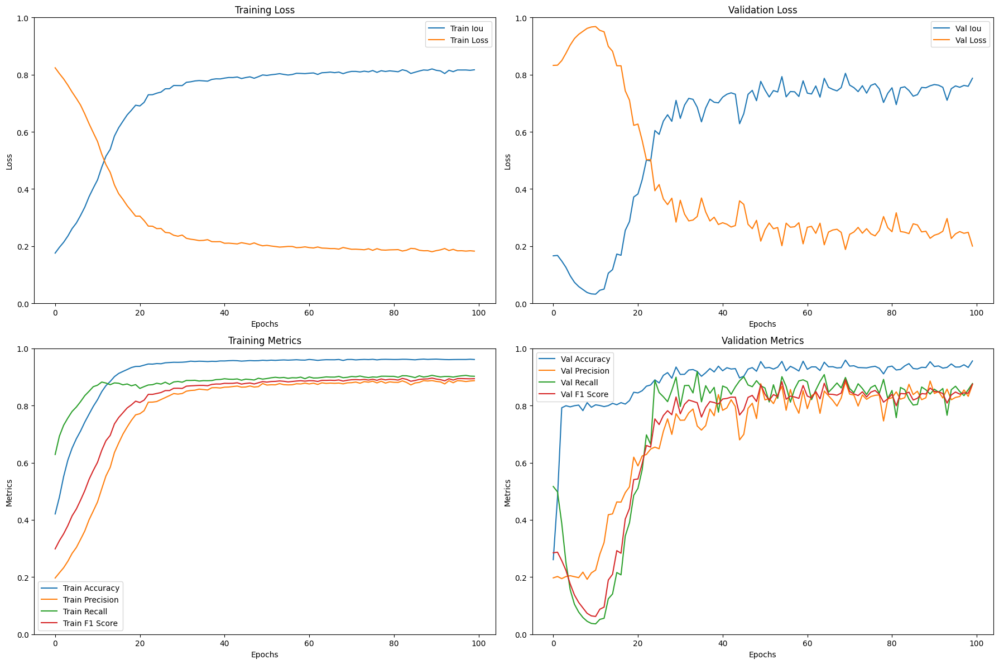

In [ ]:
import matplotlib.pyplot as plt

def print_plot_history(history):
    # Print and plot training and validation loss
    plt.figure(figsize=(18, 12))

    # Plot training loss and IOU score
    plt.subplot(2, 2, 1)
    plt.plot(history['iou_score'], label='Train Iou')
    plt.plot(history['loss'], label='Train Loss')
    plt.title('Training Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.ylim(0, 1)
    plt.legend()

    plt.subplot(2, 2, 2)
    plt.plot(history['val_iou_score'], label='Val Iou')
    plt.plot(history['val_loss'], label='Val Loss')
    plt.title('Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.ylim(0, 1)
    plt.legend()

    # Plot training and validation metrics
    plt.subplot(2, 2, 3)
    plt.plot(history['accuracy'], label='Train Accuracy')
    plt.plot(history['precision'], label='Train Precision')
    plt.plot(history['recall'], label='Train Recall')
    plt.plot(history['f1-score'], label='Train F1 Score')
    plt.title('Training Metrics')
    plt.xlabel('Epochs')
    plt.ylabel('Metrics')
    plt.ylim(0, 1)
    plt.legend()

    plt.subplot(2, 2, 4)
    plt.plot(history['val_accuracy'], label='Val Accuracy')
    plt.plot(history['val_precision'], label='Val Precision')
    plt.plot(history['val_recall'], label='Val Recall')
    plt.plot(history['val_f1-score'], label='Val F1 Score')
    plt.title('Validation Metrics')
    plt.xlabel('Epochs')
    plt.ylabel('Metrics')
    plt.ylim(0, 1)
    plt.legend()
    plt.tight_layout()
    plt.show()

print_plot_history(history)

In [ ]:
test_1_labels, test_2_labels = load_labels(TEST_1_PATH, TEST_2_PATH)

Test masks (stage 1):   0%|          | 0/65 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/59 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/75 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/115 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/66 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/205 [00:00<?, ?it/s]

  0%|          | 0/329 [00:00<?, ?it/s]

  0%|          | 0/134 [00:00<?, ?it/s]

  0%|          | 0/71 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/98 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/146 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/264 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/60 [00:00<?, ?it/s]

  0%|          | 0/129 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/34 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/38 [00:00<?, ?it/s]

  0%|          | 0/78 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/44 [00:00<?, ?it/s]

  0%|          | 0/58 [00:00<?, ?it/s]

  0%|          | 0/73 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/98 [00:00<?, ?it/s]

  0%|          | 0/60 [00:00<?, ?it/s]

  0%|          | 0/81 [00:00<?, ?it/s]

  0%|          | 0/249 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/91 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/97 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/55 [00:00<?, ?it/s]

  0%|          | 0/34 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/88 [00:00<?, ?it/s]

Test masks (stage 2):   0%|          | 0/106 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/44 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/72 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/108 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/119 [00:00<?, ?it/s]

  0%|          | 0/24 [00:00<?, ?it/s]

  0%|          | 0/54 [00:00<?, ?it/s]

  0%|          | 0/95 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/90 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/72 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/158 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/78 [00:00<?, ?it/s]

  0%|          | 0/54 [00:00<?, ?it/s]

  0%|          | 0/34 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/24 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/94 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/164 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/93 [00:00<?, ?it/s]

  0%|          | 0/74 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/123 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/78 [00:00<?, ?it/s]

  0%|          | 0/246 [00:00<?, ?it/s]

  0%|          | 0/54 [00:00<?, ?it/s]

  0%|          | 0/83 [00:00<?, ?it/s]

In [ ]:
# Prediction using TTA
# test_1_pred_masks = tta(model, test_1_images)
test_2_pred_masks = tta(model, test_2_images)

  0%|          | 0/106 [00:00<?, ?it/s]

Submission

<ipython-input-13-2968ce3b7124>:29: FutureWarning: indices argument is deprecated and will be removed in version 0.20. To avoid this warning, please do not use the indices argument. Please see peak_local_max documentation for more details.
  markers = label(peak_local_max(distance, min_distance=average_radius, footprint=disk(average_radius), threshold_rel=0.2, indices=False, exclude_border=False)) #min distance to determine


Number of true objects: 16
Number of predicted objects: 15
Thresh	TP	FP	FN	Prec.
0.500	14	1	2	0.824
0.550	14	1	2	0.824
0.600	14	1	2	0.824
0.650	14	1	2	0.824
0.700	14	1	2	0.824
0.750	14	1	2	0.824
0.800	14	1	2	0.824
0.850	14	1	2	0.824
0.900	14	1	2	0.824
0.950	9	6	7	0.409
AP	-	-	-	0.782


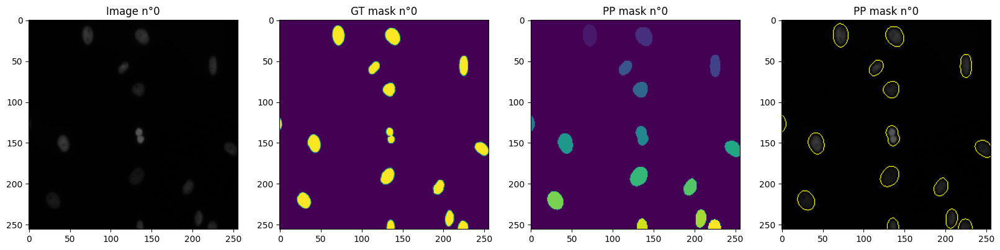

Number of true objects: 36
Number of predicted objects: 29
Thresh	TP	FP	FN	Prec.
0.500	20	9	16	0.444
0.550	19	10	17	0.413
0.600	17	12	19	0.354
0.650	17	12	19	0.354
0.700	15	14	21	0.300
0.750	14	15	22	0.275
0.800	12	17	24	0.226
0.850	7	22	29	0.121
0.900	1	28	35	0.016
0.950	0	29	36	0.000
AP	-	-	-	0.250


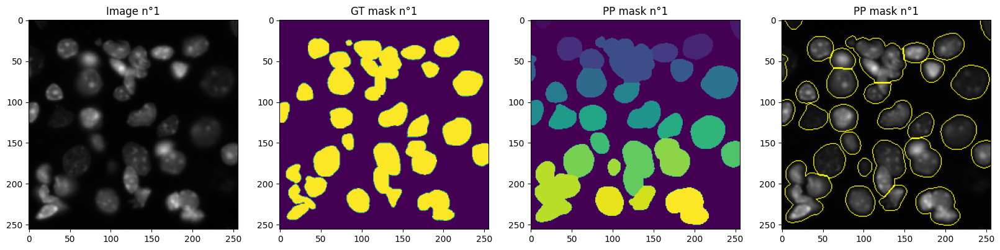

Number of true objects: 44
Number of predicted objects: 34
Thresh	TP	FP	FN	Prec.
0.500	26	8	18	0.500
0.550	23	11	21	0.418
0.600	22	12	22	0.393
0.650	21	13	23	0.368
0.700	19	15	25	0.322
0.750	18	16	26	0.300
0.800	18	16	26	0.300
0.850	10	24	34	0.147
0.900	7	27	37	0.099
0.950	1	33	43	0.013
AP	-	-	-	0.286


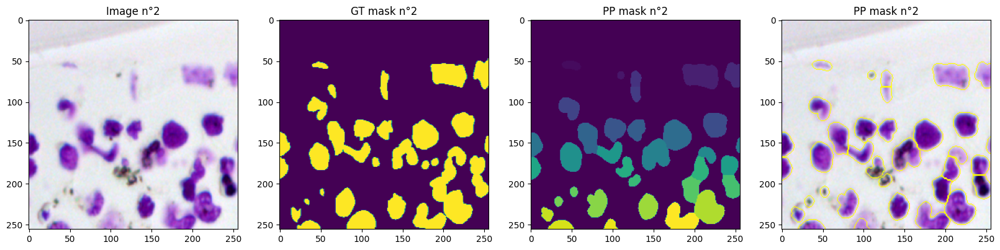

Number of true objects: 3
Number of predicted objects: 3
Thresh	TP	FP	FN	Prec.
0.500	3	0	0	1.000
0.550	3	0	0	1.000
0.600	3	0	0	1.000
0.650	3	0	0	1.000
0.700	3	0	0	1.000
0.750	3	0	0	1.000
0.800	3	0	0	1.000
0.850	3	0	0	1.000
0.900	3	0	0	1.000
0.950	0	3	3	0.000
AP	-	-	-	0.900


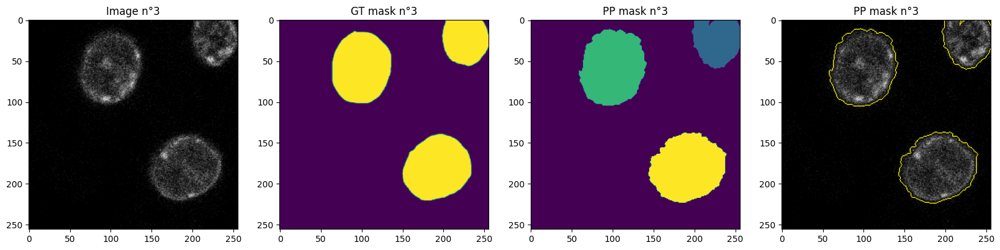

Number of true objects: 20
Number of predicted objects: 22
Thresh	TP	FP	FN	Prec.
0.500	19	3	1	0.826
0.550	19	3	1	0.826
0.600	19	3	1	0.826
0.650	19	3	1	0.826
0.700	19	3	1	0.826
0.750	17	5	3	0.680
0.800	16	6	4	0.615
0.850	11	11	9	0.355
0.900	3	19	17	0.077
0.950	0	22	20	0.000
AP	-	-	-	0.586


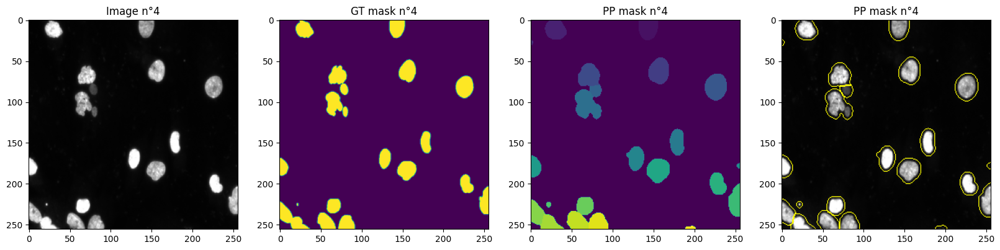

Number of true objects: 3
Number of predicted objects: 3
Thresh	TP	FP	FN	Prec.
0.500	3	0	0	1.000
0.550	3	0	0	1.000
0.600	3	0	0	1.000
0.650	3	0	0	1.000
0.700	3	0	0	1.000
0.750	3	0	0	1.000
0.800	3	0	0	1.000
0.850	3	0	0	1.000
0.900	3	0	0	1.000
0.950	2	1	1	0.500
AP	-	-	-	0.950


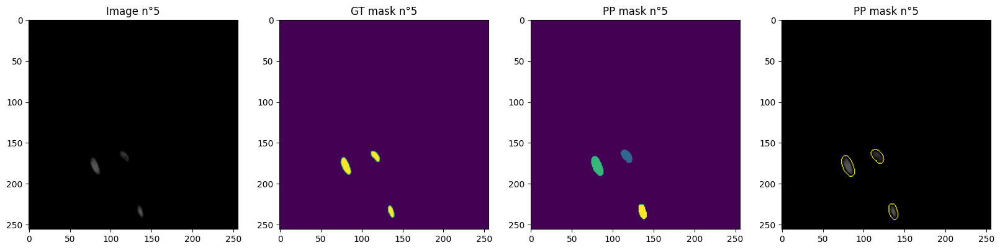

Number of true objects: 23
Number of predicted objects: 18
Thresh	TP	FP	FN	Prec.
0.500	16	2	7	0.640
0.550	16	2	7	0.640
0.600	16	2	7	0.640
0.650	16	2	7	0.640
0.700	15	3	8	0.577
0.750	15	3	8	0.577
0.800	15	3	8	0.577
0.850	15	3	8	0.577
0.900	14	4	9	0.519
0.950	11	7	12	0.367
AP	-	-	-	0.575


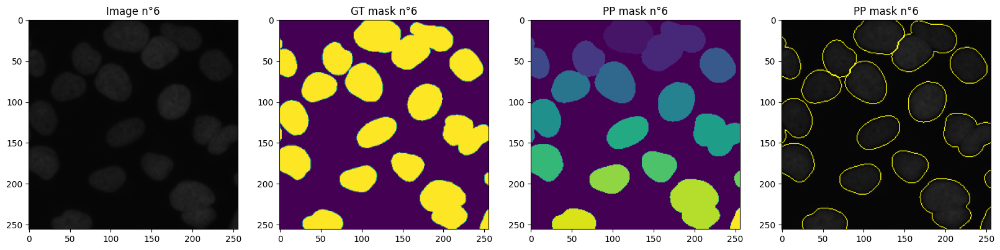

Number of true objects: 72
Number of predicted objects: 60
Thresh	TP	FP	FN	Prec.
0.500	52	8	20	0.650
0.550	49	11	23	0.590
0.600	49	11	23	0.590
0.650	46	14	26	0.535
0.700	43	17	29	0.483
0.750	41	19	31	0.451
0.800	39	21	33	0.419
0.850	30	30	42	0.294
0.900	12	48	60	0.100
0.950	3	57	69	0.023
AP	-	-	-	0.414


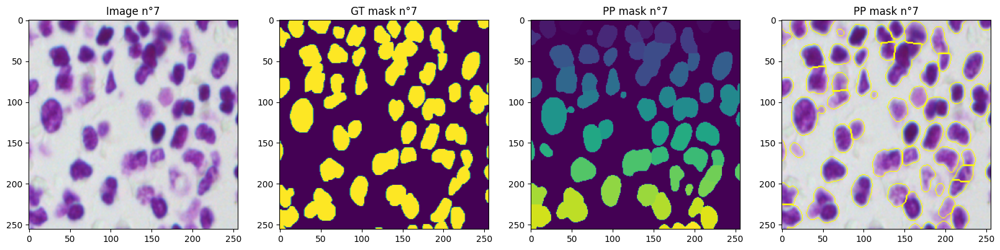

Number of true objects: 50
Number of predicted objects: 32
Thresh	TP	FP	FN	Prec.
0.500	26	6	24	0.464
0.550	26	6	24	0.464
0.600	23	9	27	0.390
0.650	21	11	29	0.344
0.700	21	11	29	0.344
0.750	19	13	31	0.302
0.800	15	17	35	0.224
0.850	12	20	38	0.171
0.900	4	28	46	0.051
0.950	0	32	50	0.000
AP	-	-	-	0.276


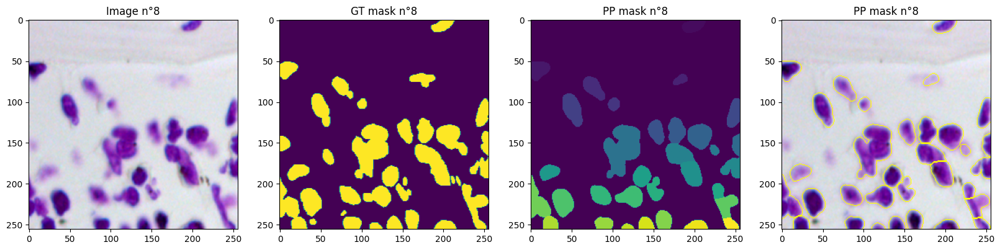

Number of true objects: 36
Number of predicted objects: 36
Thresh	TP	FP	FN	Prec.
0.500	34	2	2	0.895
0.550	34	2	2	0.895
0.600	32	4	4	0.800
0.650	32	4	4	0.800
0.700	32	4	4	0.800
0.750	19	17	17	0.358
0.800	6	30	30	0.091
0.850	1	35	35	0.014
0.900	0	36	36	0.000
0.950	0	36	36	0.000
AP	-	-	-	0.465


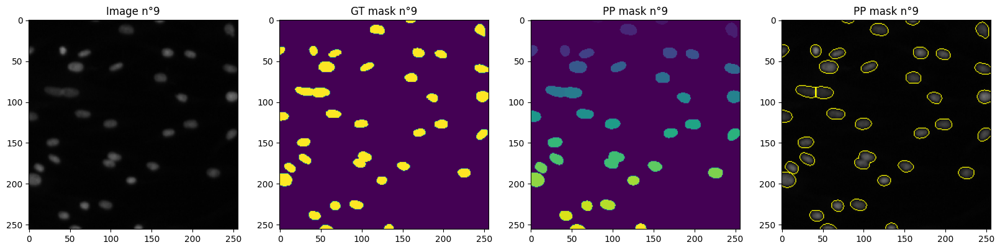

Number of true objects: 6
Number of predicted objects: 6
Thresh	TP	FP	FN	Prec.
0.500	6	0	0	1.000
0.550	6	0	0	1.000
0.600	6	0	0	1.000
0.650	6	0	0	1.000
0.700	6	0	0	1.000
0.750	6	0	0	1.000
0.800	6	0	0	1.000
0.850	6	0	0	1.000
0.900	6	0	0	1.000
0.950	2	4	4	0.200
AP	-	-	-	0.920


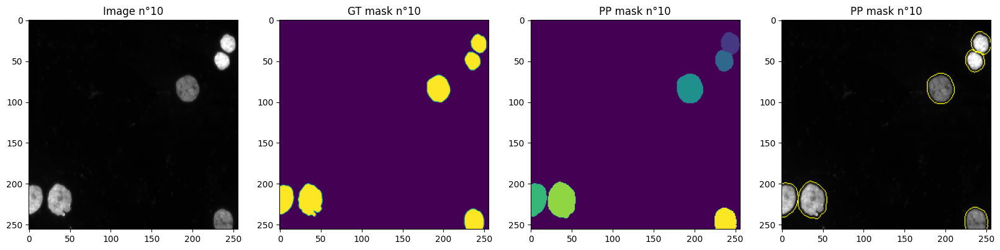

Number of true objects: 21
Number of predicted objects: 22
Thresh	TP	FP	FN	Prec.
0.500	19	3	2	0.792
0.550	18	4	3	0.720
0.600	15	7	6	0.536
0.650	13	9	8	0.433
0.700	13	9	8	0.433
0.750	12	10	9	0.387
0.800	10	12	11	0.303
0.850	9	13	12	0.265
0.900	5	17	16	0.132
0.950	1	21	20	0.024
AP	-	-	-	0.402


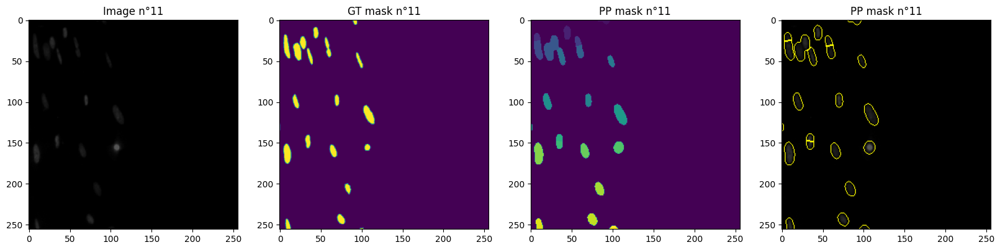

Number of true objects: 1
Number of predicted objects: 1
Thresh	TP	FP	FN	Prec.
0.500	1	0	0	1.000
0.550	1	0	0	1.000
0.600	1	0	0	1.000
0.650	1	0	0	1.000
0.700	1	0	0	1.000
0.750	1	0	0	1.000
0.800	1	0	0	1.000
0.850	1	0	0	1.000
0.900	1	0	0	1.000
0.950	0	1	1	0.000
AP	-	-	-	0.900


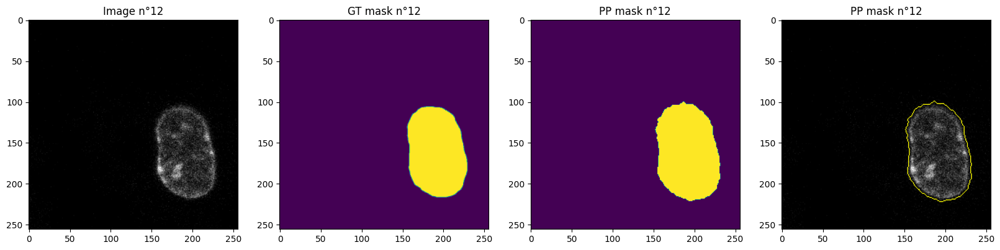

Number of true objects: 6
Number of predicted objects: 14
Thresh	TP	FP	FN	Prec.
0.500	4	10	2	0.250
0.550	4	10	2	0.250
0.600	4	10	2	0.250
0.650	4	10	2	0.250
0.700	4	10	2	0.250
0.750	4	10	2	0.250
0.800	3	11	3	0.176
0.850	2	12	4	0.111
0.900	1	13	5	0.053
0.950	1	13	5	0.053
AP	-	-	-	0.189


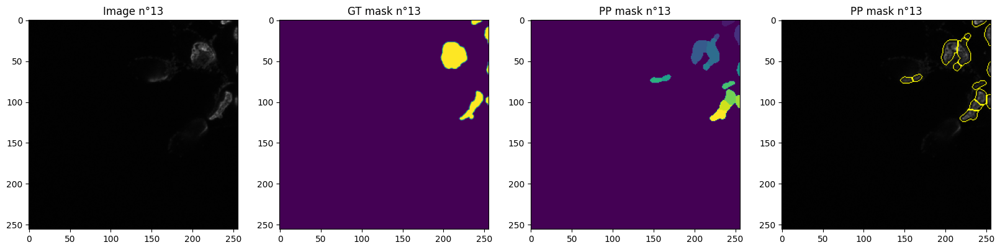

Number of true objects: 22
Number of predicted objects: 18
Thresh	TP	FP	FN	Prec.
0.500	18	0	4	0.818
0.550	18	0	4	0.818
0.600	18	0	4	0.818
0.650	18	0	4	0.818
0.700	18	0	4	0.818
0.750	18	0	4	0.818
0.800	18	0	4	0.818
0.850	17	1	5	0.739
0.900	17	1	5	0.739
0.950	11	7	11	0.379
AP	-	-	-	0.758


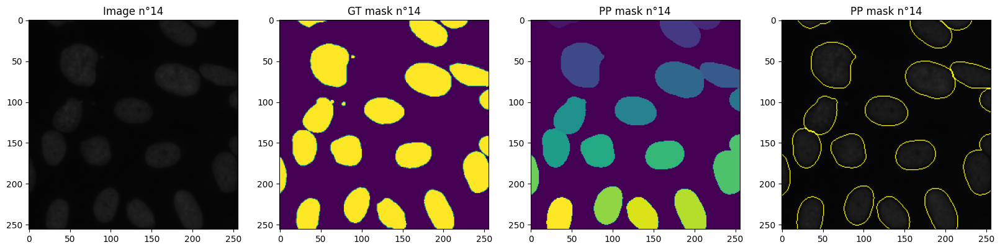

Number of true objects: 28
Number of predicted objects: 23
Thresh	TP	FP	FN	Prec.
0.500	23	0	5	0.821
0.550	23	0	5	0.821
0.600	23	0	5	0.821
0.650	23	0	5	0.821
0.700	23	0	5	0.821
0.750	23	0	5	0.821
0.800	22	1	6	0.759
0.850	22	1	6	0.759
0.900	21	2	7	0.700
0.950	9	14	19	0.214
AP	-	-	-	0.736


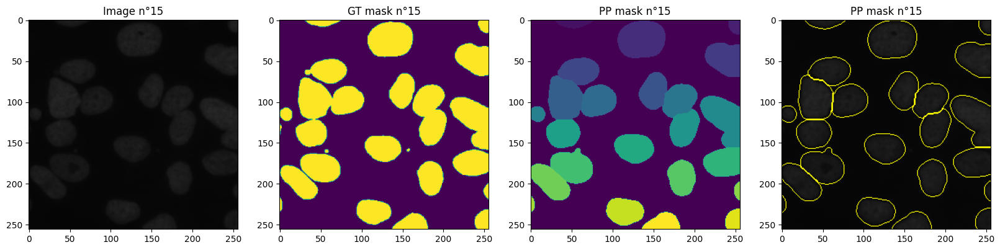

Number of true objects: 108
Number of predicted objects: 116
Thresh	TP	FP	FN	Prec.
0.500	30	86	78	0.155
0.550	17	99	91	0.082
0.600	11	105	97	0.052
0.650	2	114	106	0.009
0.700	1	115	107	0.004
0.750	0	116	108	0.000
0.800	0	116	108	0.000
0.850	0	116	108	0.000
0.900	0	116	108	0.000
0.950	0	116	108	0.000
AP	-	-	-	0.030


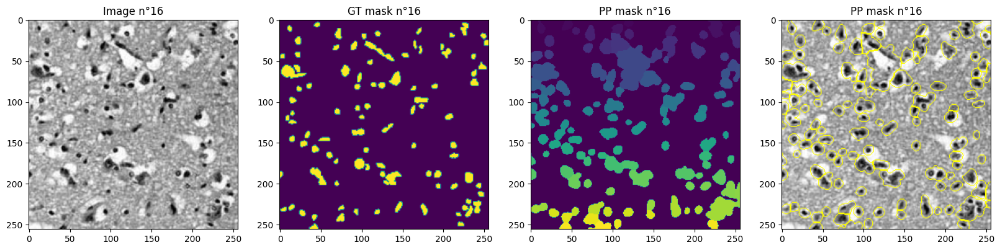

Number of true objects: 12
Number of predicted objects: 13
Thresh	TP	FP	FN	Prec.
0.500	10	3	2	0.667
0.550	10	3	2	0.667
0.600	10	3	2	0.667
0.650	10	3	2	0.667
0.700	10	3	2	0.667
0.750	10	3	2	0.667
0.800	10	3	2	0.667
0.850	8	5	4	0.471
0.900	3	10	9	0.136
0.950	1	12	11	0.042
AP	-	-	-	0.532


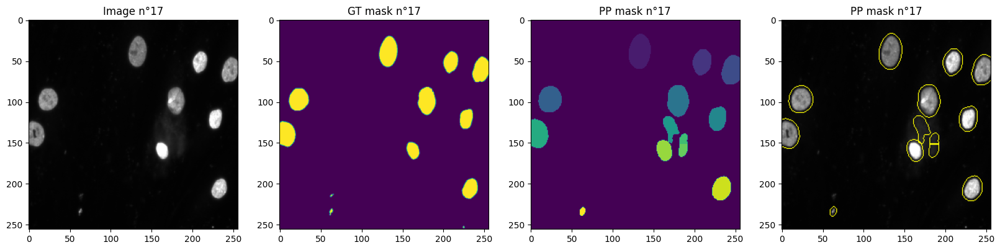

Number of true objects: 119
Number of predicted objects: 99
Thresh	TP	FP	FN	Prec.
0.500	78	21	41	0.557
0.550	78	21	41	0.557
0.600	76	23	43	0.535
0.650	70	29	49	0.473
0.700	61	38	58	0.389
0.750	43	56	76	0.246
0.800	27	72	92	0.141
0.850	12	87	107	0.058
0.900	5	94	114	0.023
0.950	0	99	119	0.000
AP	-	-	-	0.298


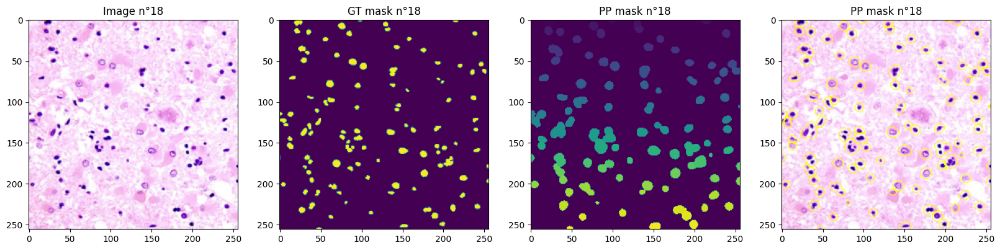

Number of true objects: 24
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	21	0	3	0.875
0.550	21	0	3	0.875
0.600	21	0	3	0.875
0.650	21	0	3	0.875
0.700	20	1	4	0.800
0.750	20	1	4	0.800
0.800	20	1	4	0.800
0.850	20	1	4	0.800
0.900	18	3	6	0.667
0.950	13	8	11	0.406
AP	-	-	-	0.777


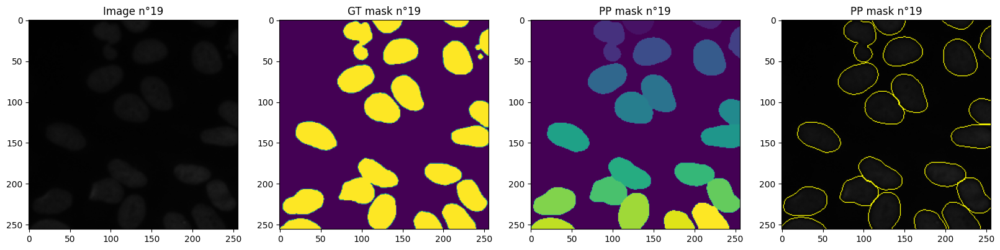

Number of true objects: 54
Number of predicted objects: 53
Thresh	TP	FP	FN	Prec.
0.500	38	15	16	0.551
0.550	35	18	19	0.486
0.600	31	22	23	0.408
0.650	30	23	24	0.390
0.700	30	23	24	0.390
0.750	30	23	24	0.390
0.800	29	24	25	0.372
0.850	27	26	27	0.338
0.900	22	31	32	0.259
0.950	8	45	46	0.081
AP	-	-	-	0.366


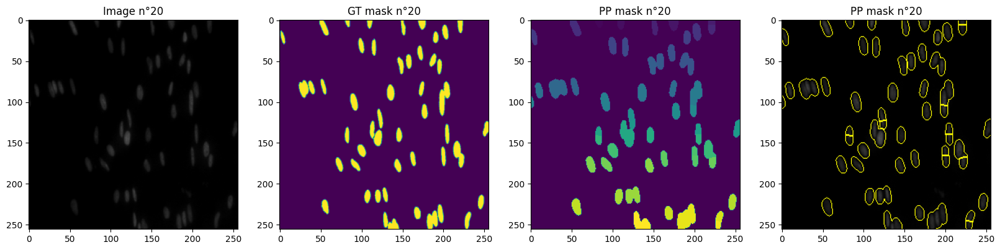

Number of true objects: 95
Number of predicted objects: 57
Thresh	TP	FP	FN	Prec.
0.500	52	5	43	0.520
0.550	48	9	47	0.462
0.600	45	12	50	0.421
0.650	42	15	53	0.382
0.700	38	19	57	0.333
0.750	34	23	61	0.288
0.800	33	24	62	0.277
0.850	27	30	68	0.216
0.900	17	40	78	0.126
0.950	1	56	94	0.007
AP	-	-	-	0.303


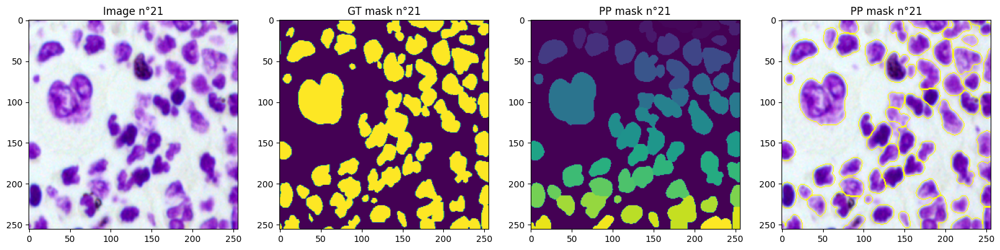

Number of true objects: 29
Number of predicted objects: 24
Thresh	TP	FP	FN	Prec.
0.500	24	0	5	0.828
0.550	24	0	5	0.828
0.600	24	0	5	0.828
0.650	23	1	6	0.767
0.700	23	1	6	0.767
0.750	23	1	6	0.767
0.800	23	1	6	0.767
0.850	22	2	7	0.710
0.900	22	2	7	0.710
0.950	12	12	17	0.293
AP	-	-	-	0.726


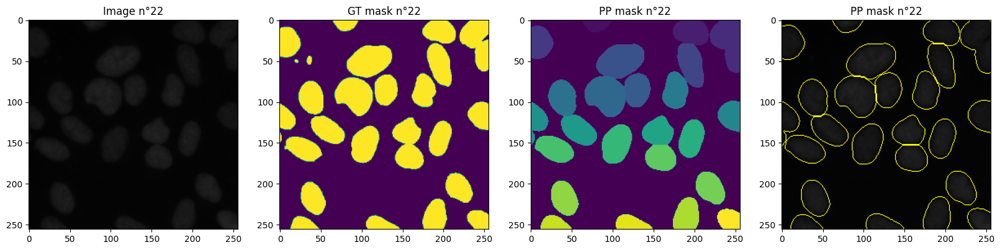

Number of true objects: 19
Number of predicted objects: 19
Thresh	TP	FP	FN	Prec.
0.500	19	0	0	1.000
0.550	19	0	0	1.000
0.600	19	0	0	1.000
0.650	19	0	0	1.000
0.700	18	1	1	0.900
0.750	18	1	1	0.900
0.800	18	1	1	0.900
0.850	17	2	2	0.810
0.900	14	5	5	0.583
0.950	4	15	15	0.118
AP	-	-	-	0.821


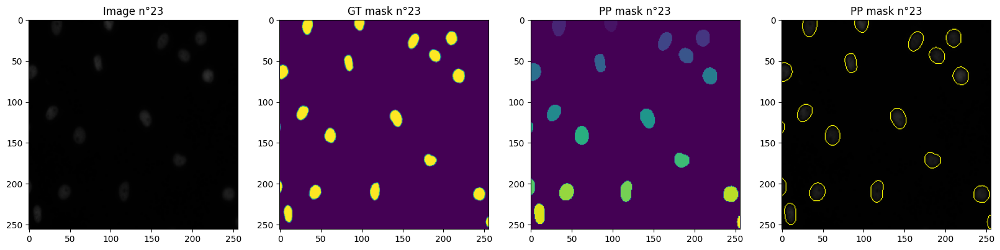

Number of true objects: 13
Number of predicted objects: 13
Thresh	TP	FP	FN	Prec.
0.500	13	0	0	1.000
0.550	13	0	0	1.000
0.600	13	0	0	1.000
0.650	13	0	0	1.000
0.700	13	0	0	1.000
0.750	13	0	0	1.000
0.800	12	1	1	0.857
0.850	12	1	1	0.857
0.900	11	2	2	0.733
0.950	3	10	10	0.130
AP	-	-	-	0.858


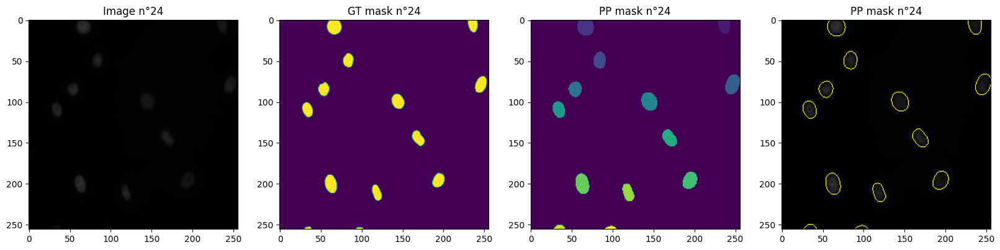

Number of true objects: 4
Number of predicted objects: 4
Thresh	TP	FP	FN	Prec.
0.500	4	0	0	1.000
0.550	4	0	0	1.000
0.600	4	0	0	1.000
0.650	3	1	1	0.600
0.700	3	1	1	0.600
0.750	3	1	1	0.600
0.800	3	1	1	0.600
0.850	2	2	2	0.333
0.900	2	2	2	0.333
0.950	0	4	4	0.000
AP	-	-	-	0.607


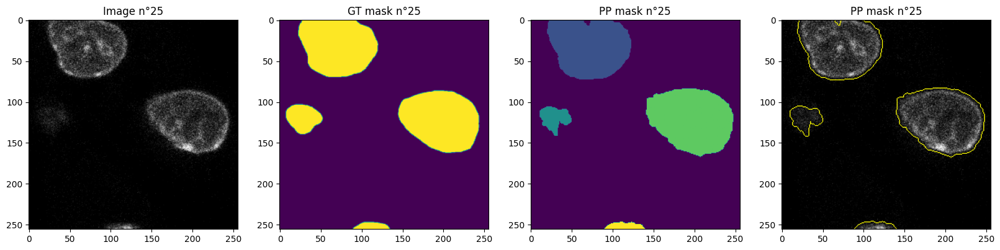

Number of true objects: 29
Number of predicted objects: 27
Thresh	TP	FP	FN	Prec.
0.500	27	0	2	0.931
0.550	25	2	4	0.806
0.600	25	2	4	0.806
0.650	25	2	4	0.806
0.700	25	2	4	0.806
0.750	25	2	4	0.806
0.800	25	2	4	0.806
0.850	22	5	7	0.647
0.900	17	10	12	0.436
0.950	5	22	24	0.098
AP	-	-	-	0.695


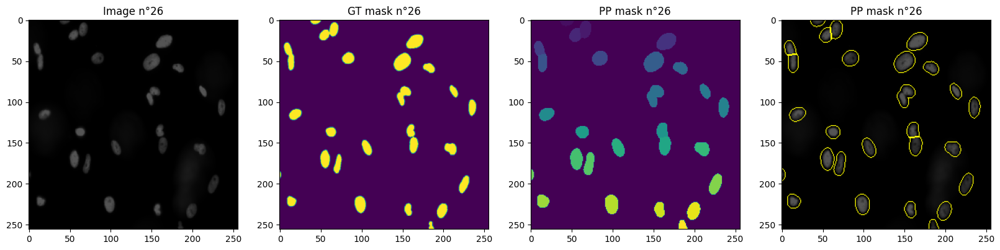

Number of true objects: 13
Number of predicted objects: 13
Thresh	TP	FP	FN	Prec.
0.500	13	0	0	1.000
0.550	13	0	0	1.000
0.600	13	0	0	1.000
0.650	13	0	0	1.000
0.700	13	0	0	1.000
0.750	13	0	0	1.000
0.800	13	0	0	1.000
0.850	11	2	2	0.733
0.900	4	9	9	0.182
0.950	0	13	13	0.000
AP	-	-	-	0.792


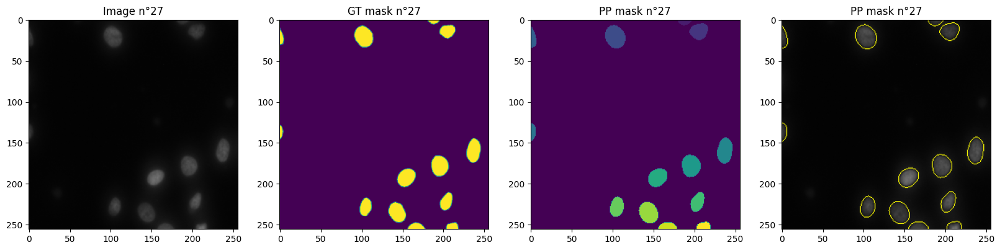

Number of true objects: 5
Number of predicted objects: 5
Thresh	TP	FP	FN	Prec.
0.500	5	0	0	1.000
0.550	4	1	1	0.667
0.600	4	1	1	0.667
0.650	4	1	1	0.667
0.700	4	1	1	0.667
0.750	4	1	1	0.667
0.800	4	1	1	0.667
0.850	3	2	2	0.429
0.900	3	2	2	0.429
0.950	0	5	5	0.000
AP	-	-	-	0.586


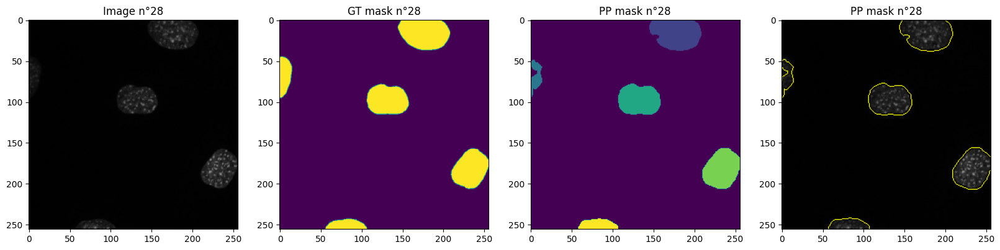

Number of true objects: 8
Number of predicted objects: 7
Thresh	TP	FP	FN	Prec.
0.500	7	0	1	0.875
0.550	7	0	1	0.875
0.600	7	0	1	0.875
0.650	7	0	1	0.875
0.700	7	0	1	0.875
0.750	7	0	1	0.875
0.800	6	1	2	0.667
0.850	5	2	3	0.500
0.900	3	4	5	0.250
0.950	1	6	7	0.071
AP	-	-	-	0.674


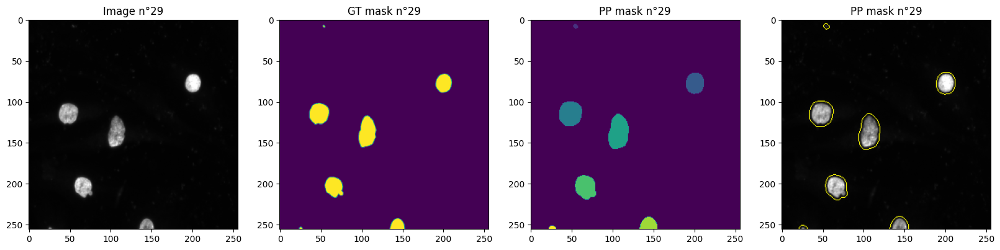

Number of true objects: 8
Number of predicted objects: 9
Thresh	TP	FP	FN	Prec.
0.500	7	2	1	0.700
0.550	7	2	1	0.700
0.600	7	2	1	0.700
0.650	7	2	1	0.700
0.700	7	2	1	0.700
0.750	7	2	1	0.700
0.800	7	2	1	0.700
0.850	5	4	3	0.417
0.900	3	6	5	0.214
0.950	1	8	7	0.062
AP	-	-	-	0.559


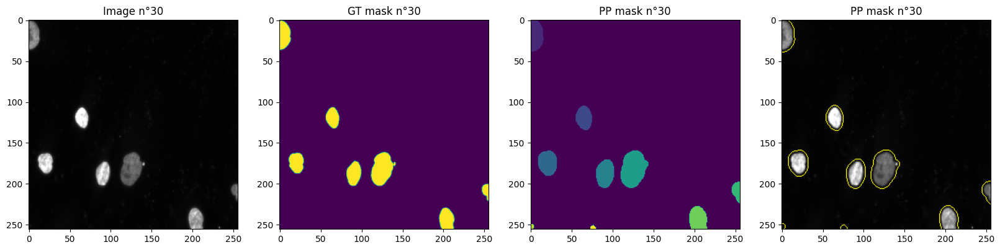

Number of true objects: 21
Number of predicted objects: 19
Thresh	TP	FP	FN	Prec.
0.500	17	2	4	0.739
0.550	17	2	4	0.739
0.600	17	2	4	0.739
0.650	17	2	4	0.739
0.700	17	2	4	0.739
0.750	17	2	4	0.739
0.800	17	2	4	0.739
0.850	15	4	6	0.600
0.900	13	6	8	0.481
0.950	6	13	15	0.176
AP	-	-	-	0.643


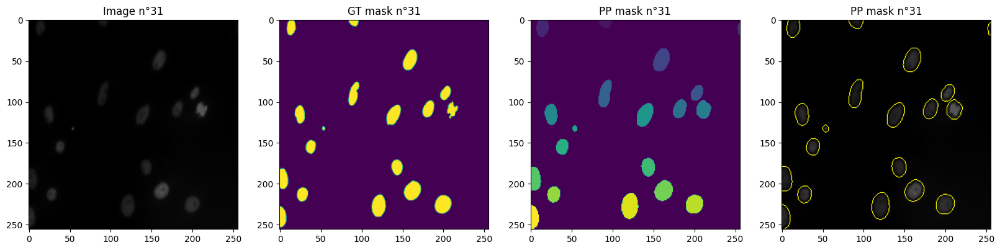

Number of true objects: 4
Number of predicted objects: 3
Thresh	TP	FP	FN	Prec.
0.500	3	0	1	0.750
0.550	3	0	1	0.750
0.600	3	0	1	0.750
0.650	3	0	1	0.750
0.700	3	0	1	0.750
0.750	3	0	1	0.750
0.800	3	0	1	0.750
0.850	3	0	1	0.750
0.900	2	1	2	0.400
0.950	0	3	4	0.000
AP	-	-	-	0.640


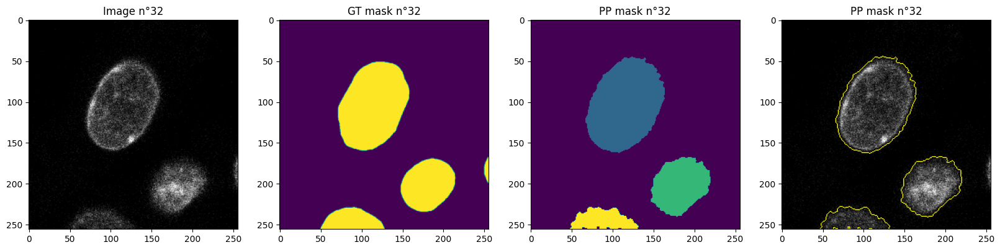

Number of true objects: 90
Number of predicted objects: 67
Thresh	TP	FP	FN	Prec.
0.500	58	9	32	0.586
0.550	56	11	34	0.554
0.600	50	17	40	0.467
0.650	48	19	42	0.440
0.700	47	20	43	0.427
0.750	44	23	46	0.389
0.800	42	25	48	0.365
0.850	33	34	57	0.266
0.900	21	46	69	0.154
0.950	2	65	88	0.013
AP	-	-	-	0.366


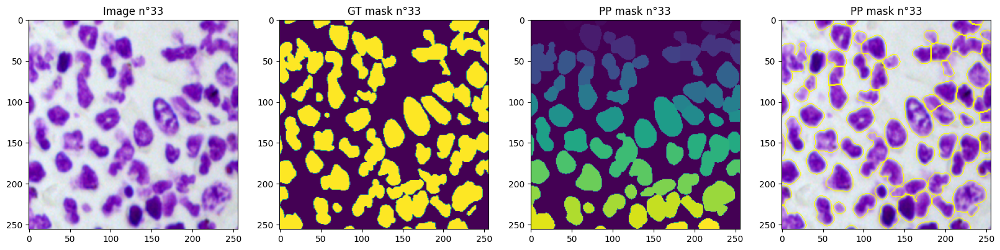

Number of true objects: 57
Number of predicted objects: 56
Thresh	TP	FP	FN	Prec.
0.500	41	15	16	0.569
0.550	39	17	18	0.527
0.600	30	26	27	0.361
0.650	28	28	29	0.329
0.700	27	29	30	0.314
0.750	25	31	32	0.284
0.800	23	33	34	0.256
0.850	17	39	40	0.177
0.900	10	46	47	0.097
0.950	2	54	55	0.018
AP	-	-	-	0.293


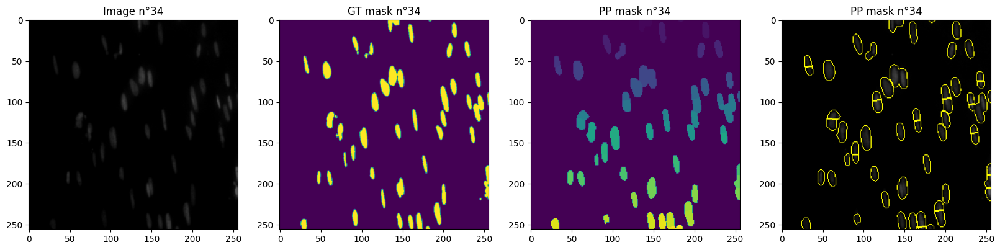

Number of true objects: 13
Number of predicted objects: 14
Thresh	TP	FP	FN	Prec.
0.500	6	8	7	0.286
0.550	5	9	8	0.227
0.600	5	9	8	0.227
0.650	4	10	9	0.174
0.700	3	11	10	0.125
0.750	3	11	10	0.125
0.800	2	12	11	0.080
0.850	1	13	12	0.038
0.900	1	13	12	0.038
0.950	0	14	13	0.000
AP	-	-	-	0.132


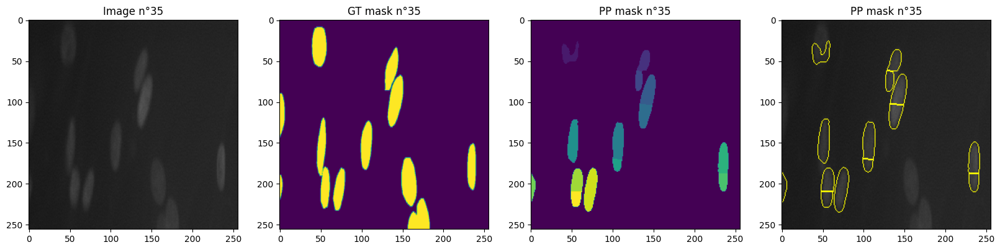

Number of true objects: 28
Number of predicted objects: 20
Thresh	TP	FP	FN	Prec.
0.500	19	1	9	0.655
0.550	18	2	10	0.600
0.600	18	2	10	0.600
0.650	17	3	11	0.548
0.700	17	3	11	0.548
0.750	17	3	11	0.548
0.800	17	3	11	0.548
0.850	16	4	12	0.500
0.900	15	5	13	0.455
0.950	7	13	21	0.171
AP	-	-	-	0.517


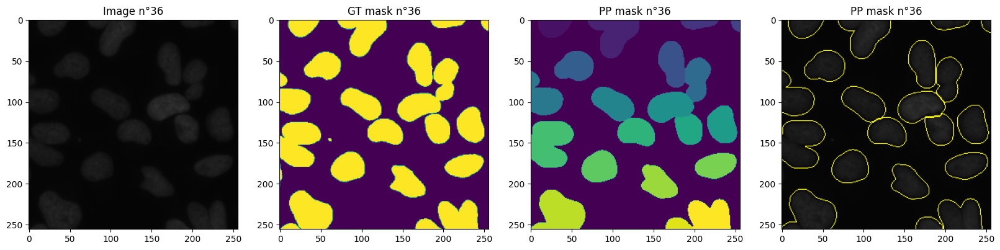

Number of true objects: 12
Number of predicted objects: 11
Thresh	TP	FP	FN	Prec.
0.500	11	0	1	0.917
0.550	11	0	1	0.917
0.600	11	0	1	0.917
0.650	11	0	1	0.917
0.700	11	0	1	0.917
0.750	11	0	1	0.917
0.800	11	0	1	0.917
0.850	9	2	3	0.643
0.900	4	7	8	0.211
0.950	0	11	12	0.000
AP	-	-	-	0.727


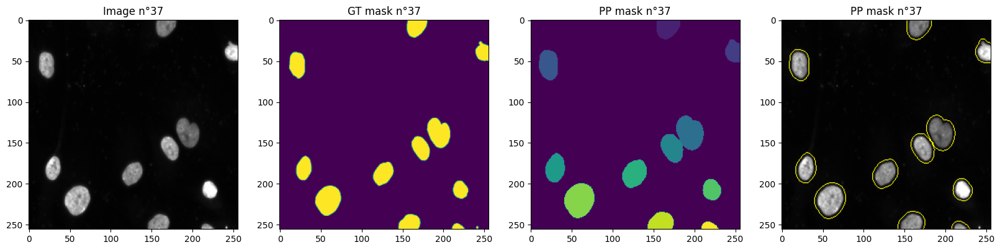

Number of true objects: 25
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	20	1	5	0.769
0.550	19	2	6	0.704
0.600	19	2	6	0.704
0.650	19	2	6	0.704
0.700	18	3	7	0.643
0.750	18	3	7	0.643
0.800	18	3	7	0.643
0.850	17	4	8	0.586
0.900	17	4	8	0.586
0.950	12	9	13	0.353
AP	-	-	-	0.633


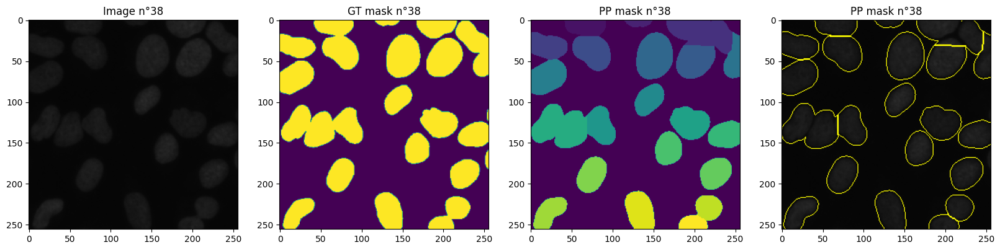

Number of true objects: 1
Number of predicted objects: 1
Thresh	TP	FP	FN	Prec.
0.500	1	0	0	1.000
0.550	1	0	0	1.000
0.600	1	0	0	1.000
0.650	1	0	0	1.000
0.700	1	0	0	1.000
0.750	1	0	0	1.000
0.800	1	0	0	1.000
0.850	1	0	0	1.000
0.900	1	0	0	1.000
0.950	0	1	1	0.000
AP	-	-	-	0.900


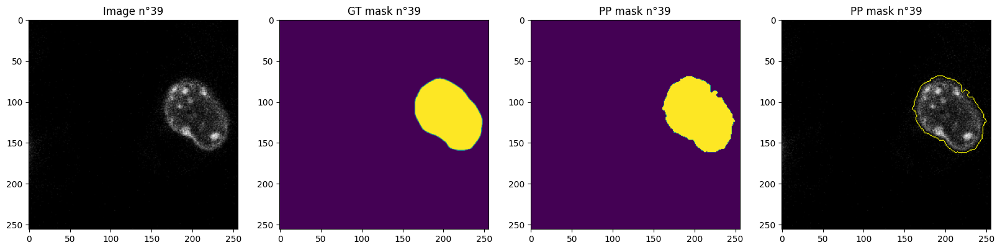

Number of true objects: 18
Number of predicted objects: 18
Thresh	TP	FP	FN	Prec.
0.500	17	1	1	0.895
0.550	17	1	1	0.895
0.600	16	2	2	0.800
0.650	15	3	3	0.714
0.700	15	3	3	0.714
0.750	15	3	3	0.714
0.800	15	3	3	0.714
0.850	13	5	5	0.565
0.900	11	7	7	0.440
0.950	4	14	14	0.125
AP	-	-	-	0.658


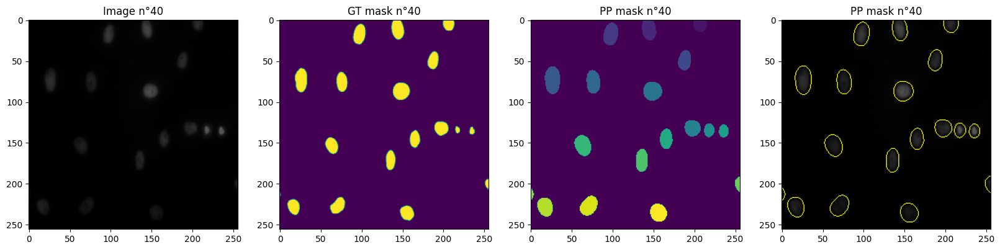

Number of true objects: 17
Number of predicted objects: 13
Thresh	TP	FP	FN	Prec.
0.500	13	0	4	0.765
0.550	12	1	5	0.667
0.600	12	1	5	0.667
0.650	11	2	6	0.579
0.700	11	2	6	0.579
0.750	11	2	6	0.579
0.800	10	3	7	0.500
0.850	7	6	10	0.304
0.900	6	7	11	0.250
0.950	2	11	15	0.071
AP	-	-	-	0.496


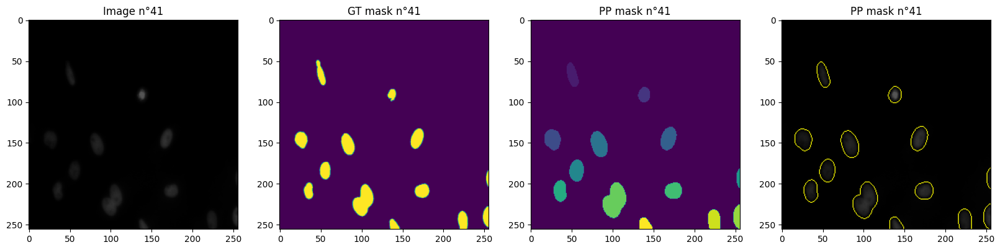

Number of true objects: 72
Number of predicted objects: 53
Thresh	TP	FP	FN	Prec.
0.500	51	2	21	0.689
0.550	48	5	24	0.623
0.600	47	6	25	0.603
0.650	45	8	27	0.562
0.700	41	12	31	0.488
0.750	40	13	32	0.471
0.800	33	20	39	0.359
0.850	28	25	44	0.289
0.900	14	39	58	0.126
0.950	1	52	71	0.008
AP	-	-	-	0.422


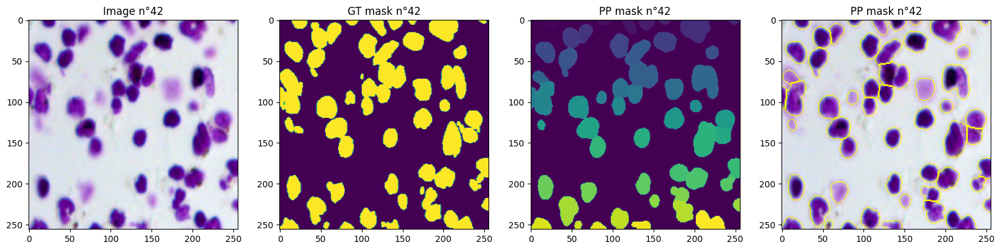

Number of true objects: 16
Number of predicted objects: 16
Thresh	TP	FP	FN	Prec.
0.500	16	0	0	1.000
0.550	16	0	0	1.000
0.600	15	1	1	0.882
0.650	15	1	1	0.882
0.700	15	1	1	0.882
0.750	14	2	2	0.778
0.800	12	4	4	0.600
0.850	11	5	5	0.524
0.900	9	7	7	0.391
0.950	1	15	15	0.032
AP	-	-	-	0.697


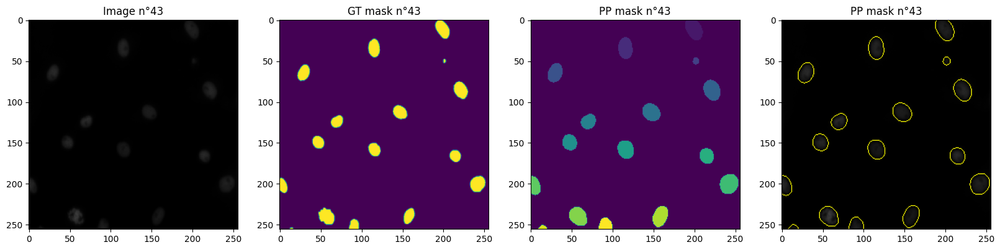

Number of true objects: 10
Number of predicted objects: 10
Thresh	TP	FP	FN	Prec.
0.500	9	1	1	0.818
0.550	9	1	1	0.818
0.600	9	1	1	0.818
0.650	9	1	1	0.818
0.700	9	1	1	0.818
0.750	9	1	1	0.818
0.800	9	1	1	0.818
0.850	9	1	1	0.818
0.900	9	1	1	0.818
0.950	6	4	4	0.429
AP	-	-	-	0.779


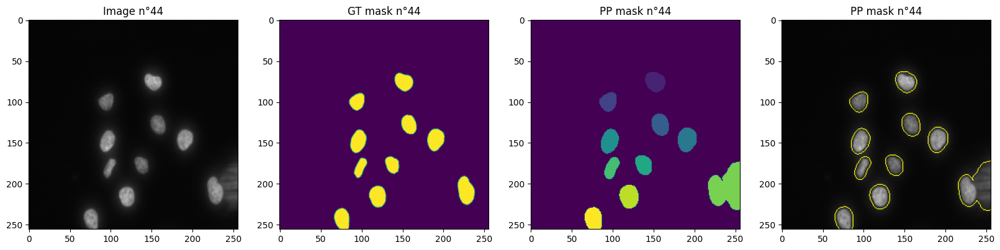

Number of true objects: 10
Number of predicted objects: 9
Thresh	TP	FP	FN	Prec.
0.500	8	1	2	0.727
0.550	8	1	2	0.727
0.600	8	1	2	0.727
0.650	8	1	2	0.727
0.700	8	1	2	0.727
0.750	8	1	2	0.727
0.800	8	1	2	0.727
0.850	6	3	4	0.462
0.900	2	7	8	0.118
0.950	0	9	10	0.000
AP	-	-	-	0.567


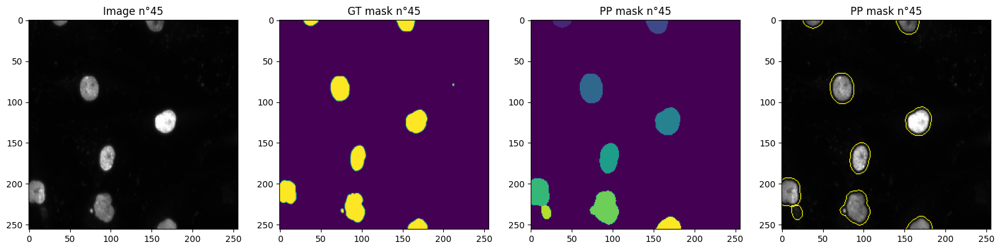

Number of true objects: 53
Number of predicted objects: 44
Thresh	TP	FP	FN	Prec.
0.500	38	6	15	0.644
0.550	34	10	19	0.540
0.600	31	13	22	0.470
0.650	30	14	23	0.448
0.700	29	15	24	0.426
0.750	27	17	26	0.386
0.800	24	20	29	0.329
0.850	18	26	35	0.228
0.900	12	32	41	0.141
0.950	0	44	53	0.000
AP	-	-	-	0.361


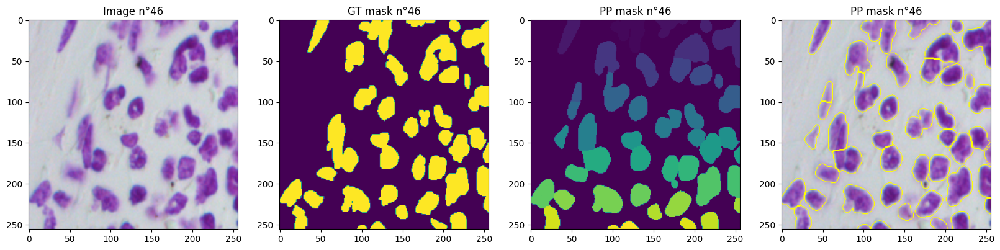

Number of true objects: 64
Number of predicted objects: 42
Thresh	TP	FP	FN	Prec.
0.500	34	8	30	0.472
0.550	33	9	31	0.452
0.600	32	10	32	0.432
0.650	32	10	32	0.432
0.700	30	12	34	0.395
0.750	27	15	37	0.342
0.800	27	15	37	0.342
0.850	23	19	41	0.277
0.900	11	31	53	0.116
0.950	0	42	64	0.000
AP	-	-	-	0.326


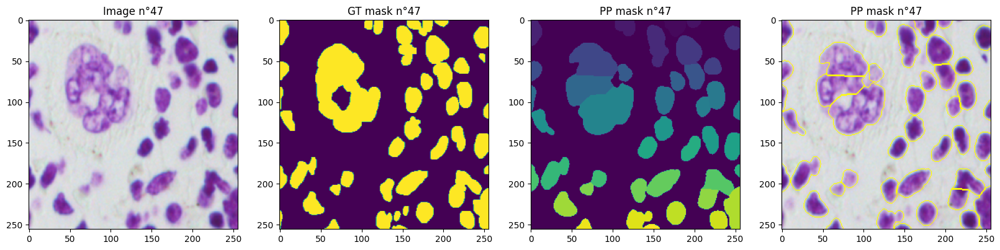

Number of true objects: 27
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	21	0	6	0.778
0.550	21	0	6	0.778
0.600	21	0	6	0.778
0.650	21	0	6	0.778
0.700	21	0	6	0.778
0.750	20	1	7	0.714
0.800	20	1	7	0.714
0.850	18	3	9	0.600
0.900	16	5	11	0.500
0.950	9	12	18	0.231
AP	-	-	-	0.665


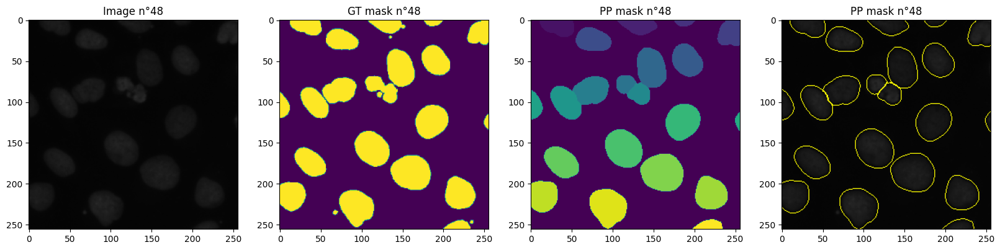

Number of true objects: 36
Number of predicted objects: 42
Thresh	TP	FP	FN	Prec.
0.500	32	10	4	0.696
0.550	30	12	6	0.625
0.600	30	12	6	0.625
0.650	25	17	11	0.472
0.700	23	19	13	0.418
0.750	23	19	13	0.418
0.800	22	20	14	0.393
0.850	21	21	15	0.368
0.900	14	28	22	0.219
0.950	5	37	31	0.068
AP	-	-	-	0.430


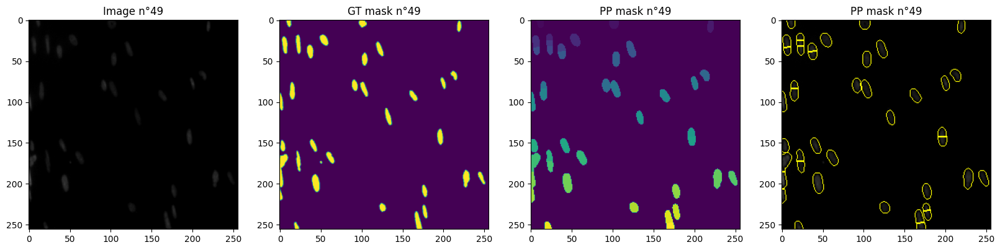

Number of true objects: 2
Number of predicted objects: 5
Thresh	TP	FP	FN	Prec.
0.500	2	3	0	0.400
0.550	2	3	0	0.400
0.600	2	3	0	0.400
0.650	2	3	0	0.400
0.700	2	3	0	0.400
0.750	2	3	0	0.400
0.800	1	4	1	0.167
0.850	0	5	2	0.000
0.900	0	5	2	0.000
0.950	0	5	2	0.000
AP	-	-	-	0.257


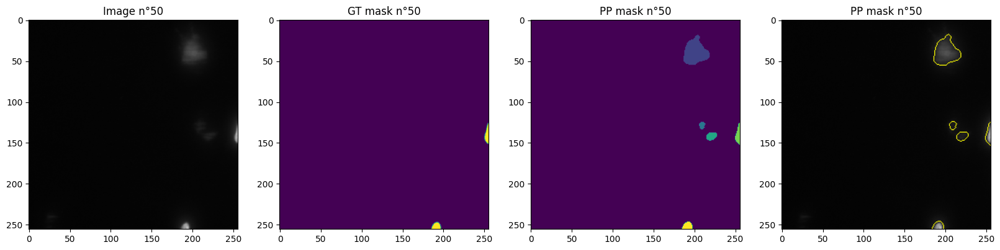

Number of true objects: 25
Number of predicted objects: 17
Thresh	TP	FP	FN	Prec.
0.500	10	7	15	0.312
0.550	10	7	15	0.312
0.600	9	8	16	0.273
0.650	9	8	16	0.273
0.700	7	10	18	0.200
0.750	7	10	18	0.200
0.800	5	12	20	0.135
0.850	2	15	23	0.050
0.900	1	16	24	0.024
0.950	0	17	25	0.000
AP	-	-	-	0.178


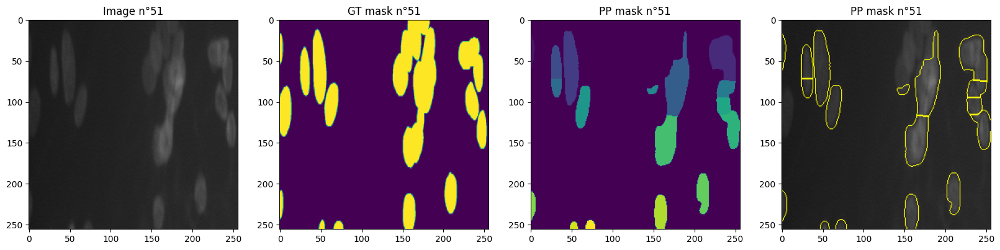

Number of true objects: 25
Number of predicted objects: 19
Thresh	TP	FP	FN	Prec.
0.500	16	3	9	0.571
0.550	15	4	10	0.517
0.600	15	4	10	0.517
0.650	15	4	10	0.517
0.700	15	4	10	0.517
0.750	15	4	10	0.517
0.800	15	4	10	0.517
0.850	15	4	10	0.517
0.900	15	4	10	0.517
0.950	7	12	18	0.189
AP	-	-	-	0.490


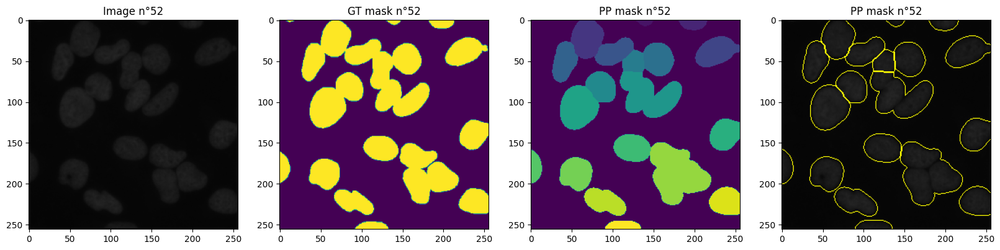

Number of true objects: 15
Number of predicted objects: 13
Thresh	TP	FP	FN	Prec.
0.500	12	1	3	0.750
0.550	12	1	3	0.750
0.600	12	1	3	0.750
0.650	12	1	3	0.750
0.700	11	2	4	0.647
0.750	11	2	4	0.647
0.800	11	2	4	0.647
0.850	10	3	5	0.556
0.900	8	5	7	0.400
0.950	3	10	12	0.120
AP	-	-	-	0.602


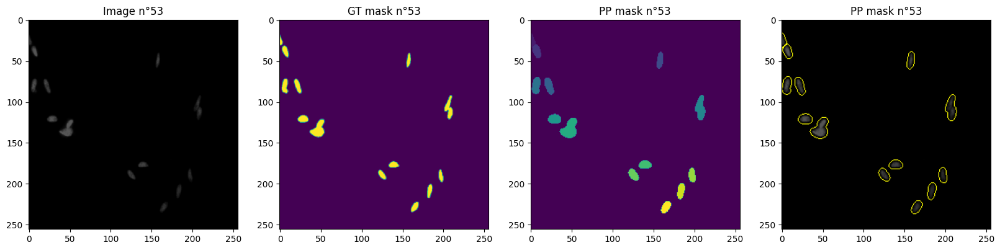

Number of true objects: 79
Number of predicted objects: 53
Thresh	TP	FP	FN	Prec.
0.500	47	6	32	0.553
0.550	44	9	35	0.500
0.600	43	10	36	0.483
0.650	40	13	39	0.435
0.700	40	13	39	0.435
0.750	36	17	43	0.375
0.800	33	20	46	0.333
0.850	27	26	52	0.257
0.900	12	41	67	0.100
0.950	1	52	78	0.008
AP	-	-	-	0.348


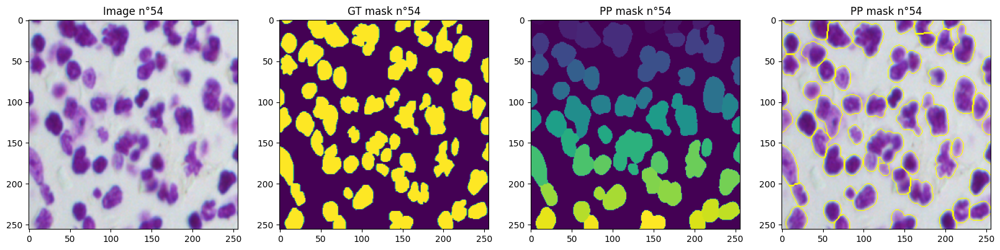

Number of true objects: 158
Number of predicted objects: 84
Thresh	TP	FP	FN	Prec.
0.500	51	33	107	0.267
0.550	45	39	113	0.228
0.600	40	44	118	0.198
0.650	32	52	126	0.152
0.700	28	56	130	0.131
0.750	23	61	135	0.105
0.800	16	68	142	0.071
0.850	8	76	150	0.034
0.900	1	83	157	0.004
0.950	0	84	158	0.000
AP	-	-	-	0.119


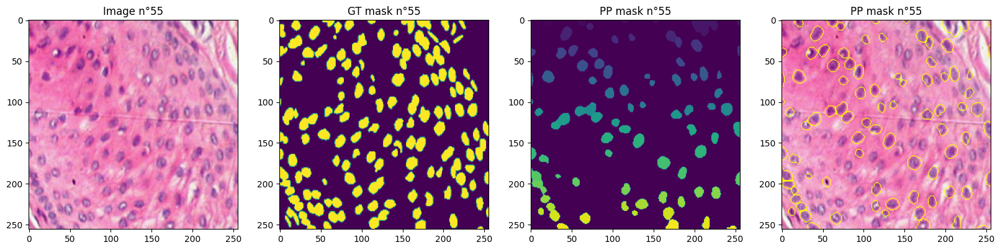

Number of true objects: 31
Number of predicted objects: 31
Thresh	TP	FP	FN	Prec.
0.500	27	4	4	0.771
0.550	27	4	4	0.771
0.600	27	4	4	0.771
0.650	27	4	4	0.771
0.700	26	5	5	0.722
0.750	22	9	9	0.550
0.800	17	14	14	0.378
0.850	10	21	21	0.192
0.900	2	29	29	0.033
0.950	1	30	30	0.016
AP	-	-	-	0.498


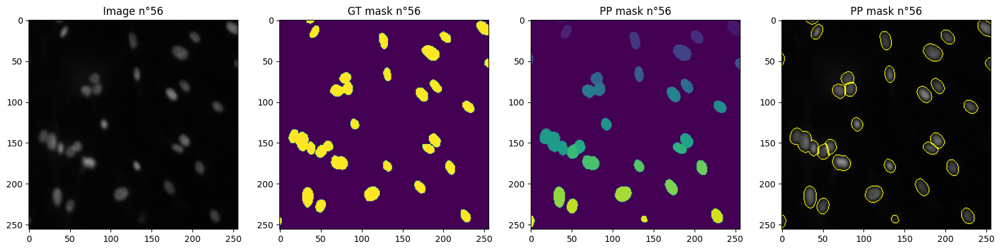

Number of true objects: 100
Number of predicted objects: 62
Thresh	TP	FP	FN	Prec.
0.500	54	8	46	0.500
0.550	47	15	53	0.409
0.600	44	18	56	0.373
0.650	44	18	56	0.373
0.700	42	20	58	0.350
0.750	40	22	60	0.328
0.800	36	26	64	0.286
0.850	32	30	68	0.246
0.900	18	44	82	0.125
0.950	0	62	100	0.000
AP	-	-	-	0.299


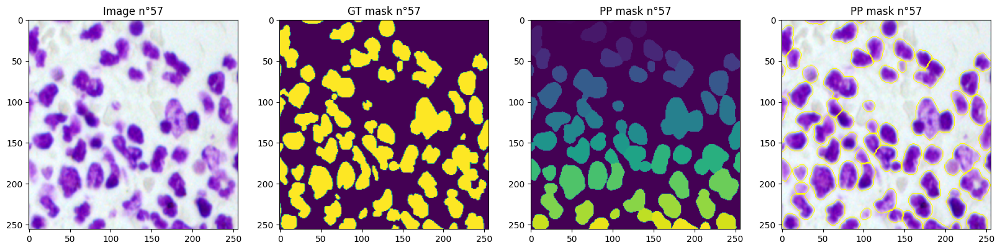

Number of true objects: 19
Number of predicted objects: 17
Thresh	TP	FP	FN	Prec.
0.500	17	0	2	0.895
0.550	17	0	2	0.895
0.600	17	0	2	0.895
0.650	17	0	2	0.895
0.700	17	0	2	0.895
0.750	17	0	2	0.895
0.800	17	0	2	0.895
0.850	15	2	4	0.714
0.900	15	2	4	0.714
0.950	6	11	13	0.200
AP	-	-	-	0.789


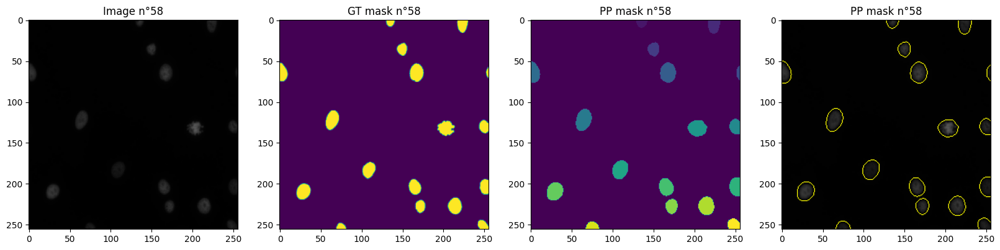

Number of true objects: 14
Number of predicted objects: 20
Thresh	TP	FP	FN	Prec.
0.500	7	13	7	0.259
0.550	6	14	8	0.214
0.600	5	15	9	0.172
0.650	4	16	10	0.133
0.700	4	16	10	0.133
0.750	4	16	10	0.133
0.800	4	16	10	0.133
0.850	2	18	12	0.062
0.900	1	19	13	0.030
0.950	0	20	14	0.000
AP	-	-	-	0.127


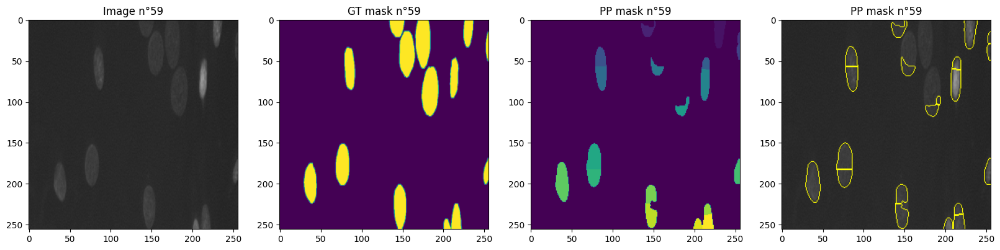

Number of true objects: 12
Number of predicted objects: 17
Thresh	TP	FP	FN	Prec.
0.500	12	5	0	0.706
0.550	12	5	0	0.706
0.600	12	5	0	0.706
0.650	12	5	0	0.706
0.700	10	7	2	0.526
0.750	9	8	3	0.450
0.800	8	9	4	0.381
0.850	3	14	9	0.115
0.900	1	16	11	0.036
0.950	0	17	12	0.000
AP	-	-	-	0.433


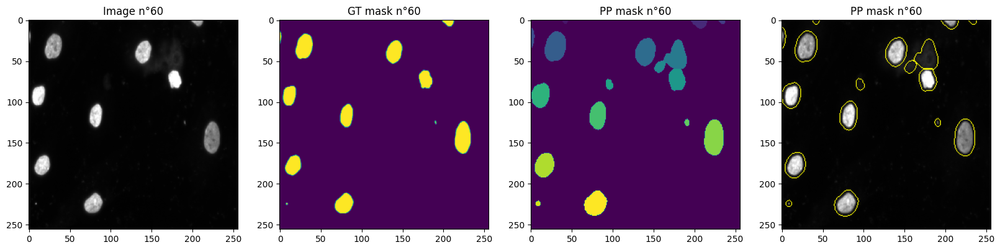

Number of true objects: 8
Number of predicted objects: 8
Thresh	TP	FP	FN	Prec.
0.500	8	0	0	1.000
0.550	8	0	0	1.000
0.600	8	0	0	1.000
0.650	8	0	0	1.000
0.700	8	0	0	1.000
0.750	8	0	0	1.000
0.800	8	0	0	1.000
0.850	6	2	2	0.600
0.900	5	3	3	0.455
0.950	2	6	6	0.143
AP	-	-	-	0.820


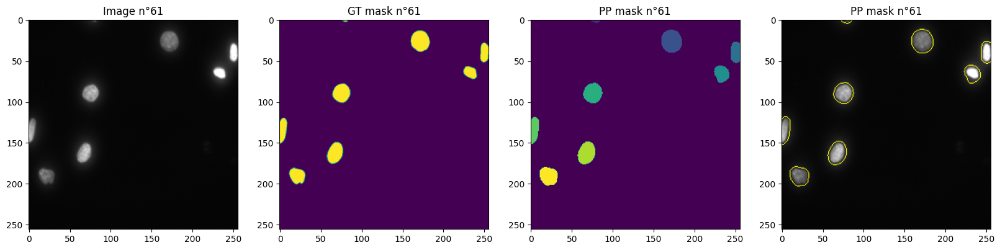

Number of true objects: 20
Number of predicted objects: 18
Thresh	TP	FP	FN	Prec.
0.500	18	0	2	0.900
0.550	18	0	2	0.900
0.600	18	0	2	0.900
0.650	18	0	2	0.900
0.700	18	0	2	0.900
0.750	18	0	2	0.900
0.800	18	0	2	0.900
0.850	18	0	2	0.900
0.900	17	1	3	0.810
0.950	7	11	13	0.226
AP	-	-	-	0.824


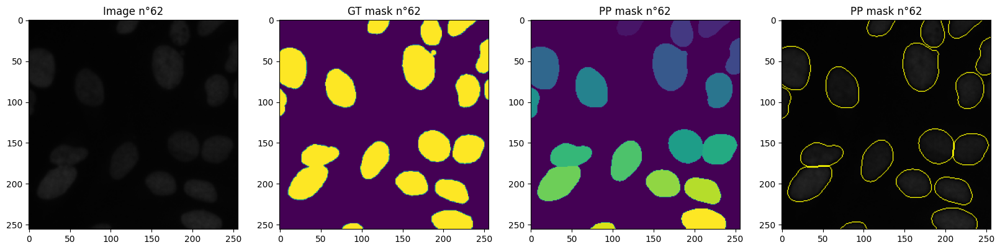

Number of true objects: 16
Number of predicted objects: 34
Thresh	TP	FP	FN	Prec.
0.500	6	28	10	0.136
0.550	3	31	13	0.064
0.600	3	31	13	0.064
0.650	3	31	13	0.064
0.700	3	31	13	0.064
0.750	2	32	14	0.042
0.800	1	33	15	0.020
0.850	1	33	15	0.020
0.900	0	34	16	0.000
0.950	0	34	16	0.000
AP	-	-	-	0.047


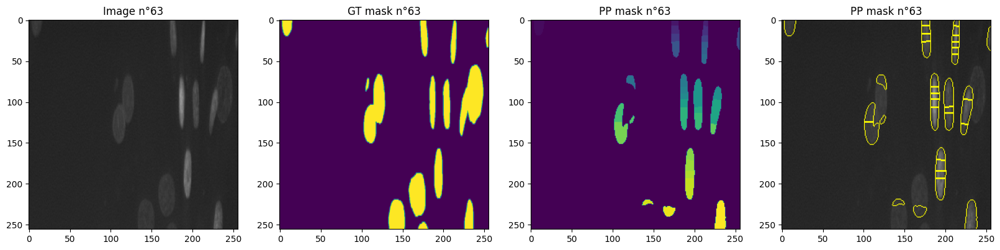

Number of true objects: 22
Number of predicted objects: 18
Thresh	TP	FP	FN	Prec.
0.500	18	0	4	0.818
0.550	18	0	4	0.818
0.600	18	0	4	0.818
0.650	18	0	4	0.818
0.700	17	1	5	0.739
0.750	16	2	6	0.667
0.800	16	2	6	0.667
0.850	14	4	8	0.538
0.900	13	5	9	0.481
0.950	6	12	16	0.176
AP	-	-	-	0.654


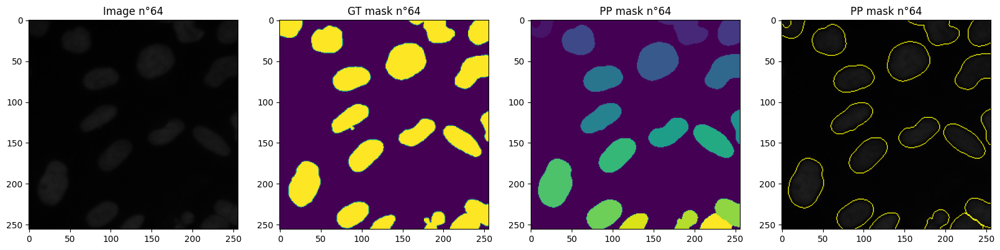

Number of true objects: 1
Number of predicted objects: 1
Thresh	TP	FP	FN	Prec.
0.500	1	0	0	1.000
0.550	1	0	0	1.000
0.600	1	0	0	1.000
0.650	1	0	0	1.000
0.700	1	0	0	1.000
0.750	1	0	0	1.000
0.800	1	0	0	1.000
0.850	1	0	0	1.000
0.900	1	0	0	1.000
0.950	0	1	1	0.000
AP	-	-	-	0.900


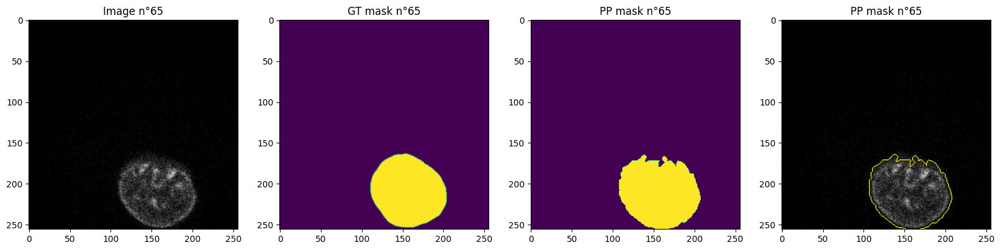

Number of true objects: 28
Number of predicted objects: 27
Thresh	TP	FP	FN	Prec.
0.500	27	0	1	0.964
0.550	27	0	1	0.964
0.600	27	0	1	0.964
0.650	27	0	1	0.964
0.700	26	1	2	0.897
0.750	25	2	3	0.833
0.800	24	3	4	0.774
0.850	21	6	7	0.618
0.900	19	8	9	0.528
0.950	8	19	20	0.170
AP	-	-	-	0.768


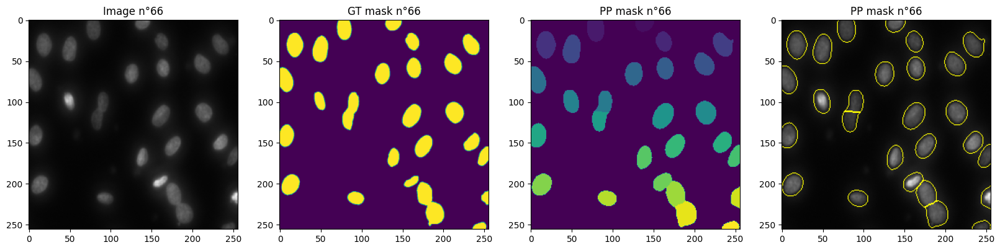

Number of true objects: 50
Number of predicted objects: 44
Thresh	TP	FP	FN	Prec.
0.500	38	6	12	0.679
0.550	37	7	13	0.649
0.600	36	8	14	0.621
0.650	33	11	17	0.541
0.700	28	16	22	0.424
0.750	28	16	22	0.424
0.800	28	16	22	0.424
0.850	26	18	24	0.382
0.900	14	30	36	0.175
0.950	1	43	49	0.011
AP	-	-	-	0.433


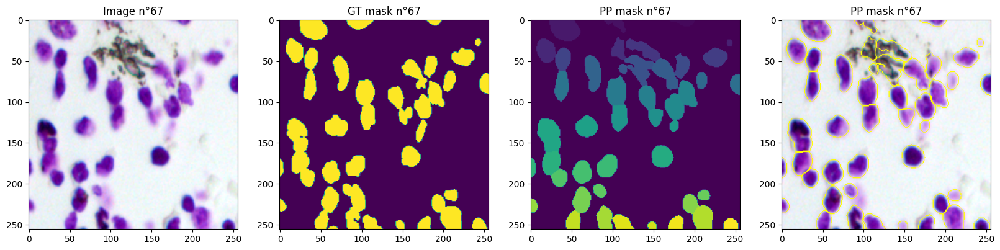

Number of true objects: 5
Number of predicted objects: 3
Thresh	TP	FP	FN	Prec.
0.500	3	0	2	0.600
0.550	3	0	2	0.600
0.600	3	0	2	0.600
0.650	3	0	2	0.600
0.700	3	0	2	0.600
0.750	3	0	2	0.600
0.800	2	1	3	0.333
0.850	2	1	3	0.333
0.900	2	1	3	0.333
0.950	0	3	5	0.000
AP	-	-	-	0.460


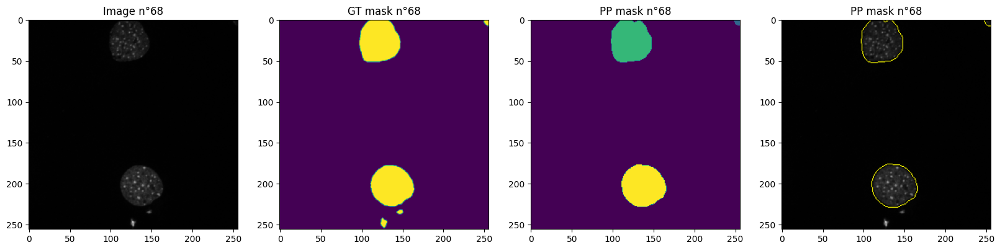

Number of true objects: 11
Number of predicted objects: 8
Thresh	TP	FP	FN	Prec.
0.500	8	0	3	0.727
0.550	8	0	3	0.727
0.600	8	0	3	0.727
0.650	7	1	4	0.583
0.700	7	1	4	0.583
0.750	7	1	4	0.583
0.800	7	1	4	0.583
0.850	7	1	4	0.583
0.900	6	2	5	0.462
0.950	1	7	10	0.056
AP	-	-	-	0.562


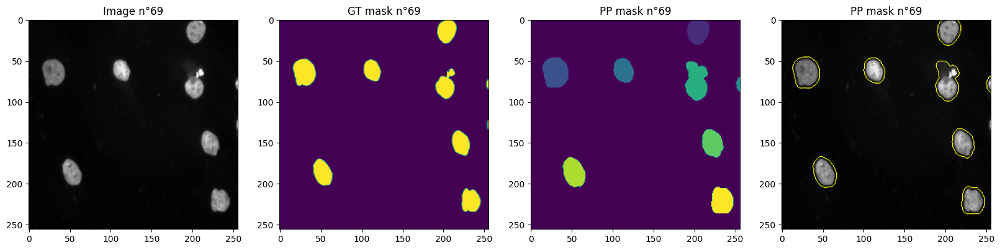

Number of true objects: 40
Number of predicted objects: 44
Thresh	TP	FP	FN	Prec.
0.500	40	4	0	0.909
0.550	40	4	0	0.909
0.600	40	4	0	0.909
0.650	40	4	0	0.909
0.700	39	5	1	0.867
0.750	34	10	6	0.680
0.800	27	17	13	0.474
0.850	10	34	30	0.135
0.900	2	42	38	0.024
0.950	1	43	39	0.012
AP	-	-	-	0.583


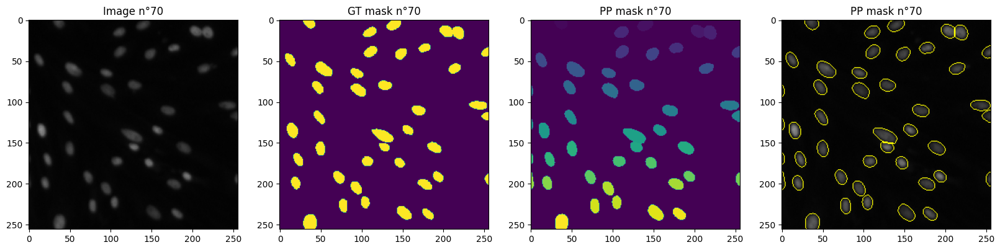

Number of true objects: 4
Number of predicted objects: 7
Thresh	TP	FP	FN	Prec.
0.500	2	5	2	0.222
0.550	2	5	2	0.222
0.600	2	5	2	0.222
0.650	2	5	2	0.222
0.700	2	5	2	0.222
0.750	2	5	2	0.222
0.800	2	5	2	0.222
0.850	2	5	2	0.222
0.900	0	7	4	0.000
0.950	0	7	4	0.000
AP	-	-	-	0.178


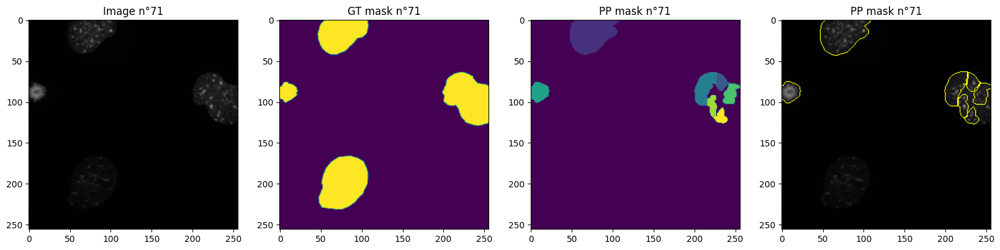

Number of true objects: 14
Number of predicted objects: 14
Thresh	TP	FP	FN	Prec.
0.500	12	2	2	0.750
0.550	11	3	3	0.647
0.600	10	4	4	0.556
0.650	10	4	4	0.556
0.700	10	4	4	0.556
0.750	10	4	4	0.556
0.800	10	4	4	0.556
0.850	10	4	4	0.556
0.900	9	5	5	0.474
0.950	4	10	10	0.167
AP	-	-	-	0.537


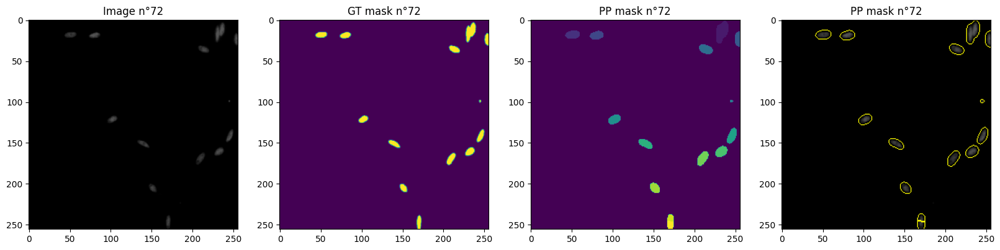

Number of true objects: 30
Number of predicted objects: 25
Thresh	TP	FP	FN	Prec.
0.500	25	0	5	0.833
0.550	25	0	5	0.833
0.600	25	0	5	0.833
0.650	25	0	5	0.833
0.700	25	0	5	0.833
0.750	25	0	5	0.833
0.800	25	0	5	0.833
0.850	24	1	6	0.774
0.900	23	2	7	0.719
0.950	9	16	21	0.196
AP	-	-	-	0.752


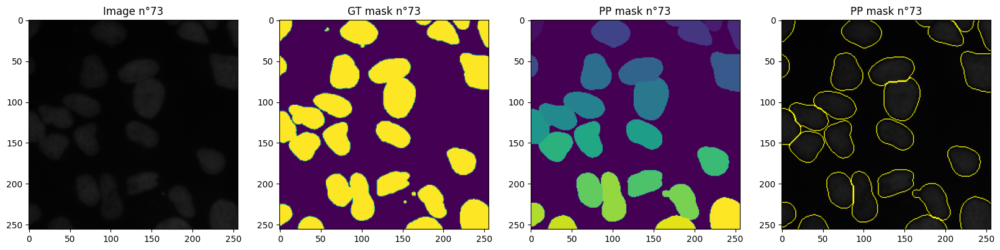

Number of true objects: 78
Number of predicted objects: 58
Thresh	TP	FP	FN	Prec.
0.500	50	8	28	0.581
0.550	48	10	30	0.545
0.600	45	13	33	0.495
0.650	41	17	37	0.432
0.700	41	17	37	0.432
0.750	38	20	40	0.388
0.800	30	28	48	0.283
0.850	22	36	56	0.193
0.900	8	50	70	0.062
0.950	0	58	78	0.000
AP	-	-	-	0.341


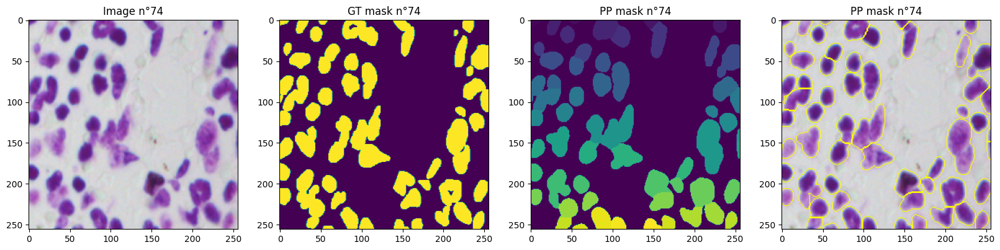

Number of true objects: 54
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	15	6	39	0.250
0.550	14	7	40	0.230
0.600	14	7	40	0.230
0.650	13	8	41	0.210
0.700	13	8	41	0.210
0.750	12	9	42	0.190
0.800	11	10	43	0.172
0.850	7	14	47	0.103
0.900	0	21	54	0.000
0.950	0	21	54	0.000
AP	-	-	-	0.159


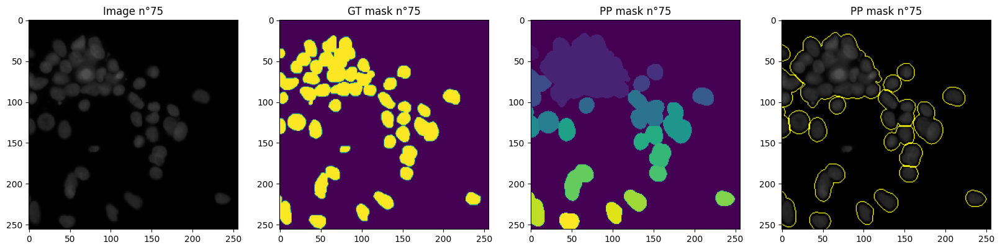

Number of true objects: 34
Number of predicted objects: 34
Thresh	TP	FP	FN	Prec.
0.500	33	1	1	0.943
0.550	32	2	2	0.889
0.600	30	4	4	0.789
0.650	29	5	5	0.744
0.700	26	8	8	0.619
0.750	13	21	21	0.236
0.800	9	25	25	0.153
0.850	0	34	34	0.000
0.900	0	34	34	0.000
0.950	0	34	34	0.000
AP	-	-	-	0.437


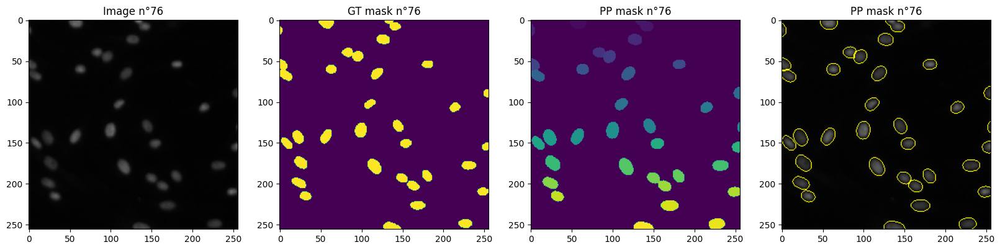

Number of true objects: 32
Number of predicted objects: 27
Thresh	TP	FP	FN	Prec.
0.500	24	3	8	0.686
0.550	21	6	11	0.553
0.600	21	6	11	0.553
0.650	21	6	11	0.553
0.700	21	6	11	0.553
0.750	21	6	11	0.553
0.800	19	8	13	0.475
0.850	17	10	15	0.405
0.900	10	17	22	0.204
0.950	2	25	30	0.035
AP	-	-	-	0.457


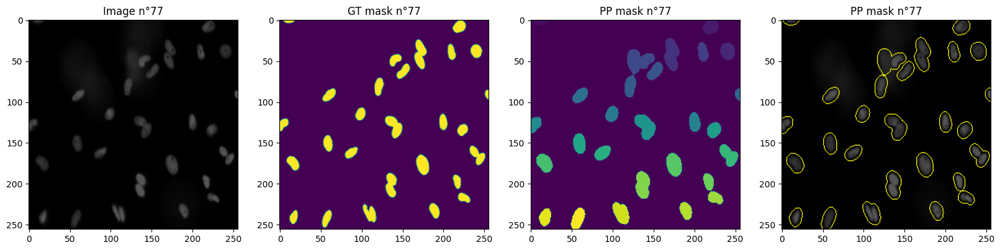

Number of true objects: 29
Number of predicted objects: 23
Thresh	TP	FP	FN	Prec.
0.500	22	1	7	0.733
0.550	21	2	8	0.677
0.600	21	2	8	0.677
0.650	21	2	8	0.677
0.700	21	2	8	0.677
0.750	21	2	8	0.677
0.800	21	2	8	0.677
0.850	18	5	11	0.529
0.900	14	9	15	0.368
0.950	9	14	20	0.209
AP	-	-	-	0.590


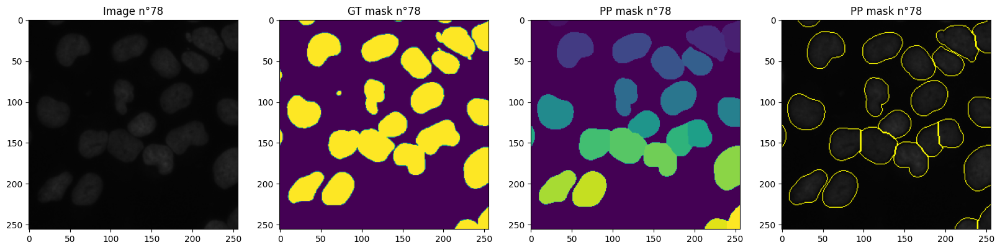

Number of true objects: 10
Number of predicted objects: 8
Thresh	TP	FP	FN	Prec.
0.500	8	0	2	0.800
0.550	8	0	2	0.800
0.600	7	1	3	0.636
0.650	7	1	3	0.636
0.700	7	1	3	0.636
0.750	6	2	4	0.500
0.800	6	2	4	0.500
0.850	6	2	4	0.500
0.900	3	5	7	0.200
0.950	1	7	9	0.059
AP	-	-	-	0.527


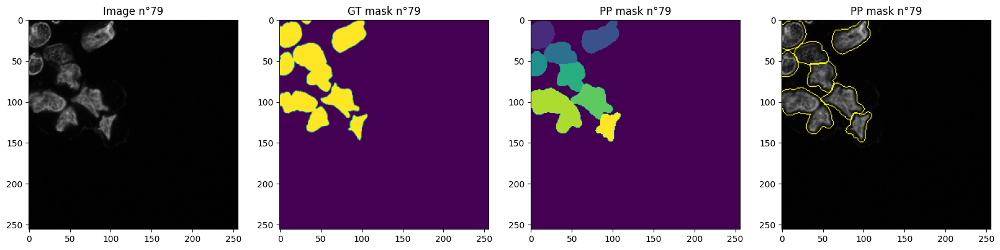

Number of true objects: 3
Number of predicted objects: 4
Thresh	TP	FP	FN	Prec.
0.500	3	1	0	0.750
0.550	3	1	0	0.750
0.600	3	1	0	0.750
0.650	3	1	0	0.750
0.700	3	1	0	0.750
0.750	3	1	0	0.750
0.800	3	1	0	0.750
0.850	3	1	0	0.750
0.900	3	1	0	0.750
0.950	2	2	1	0.400
AP	-	-	-	0.715


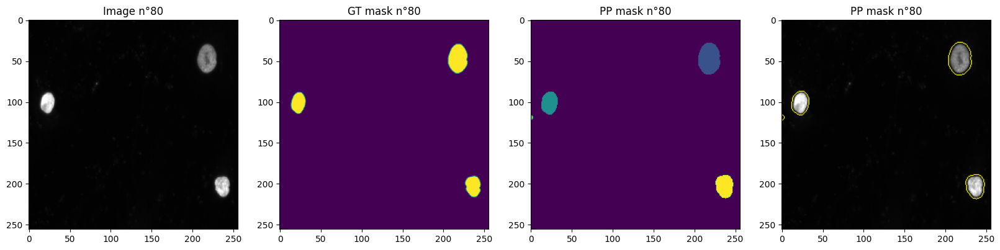

Number of true objects: 5
Number of predicted objects: 6
Thresh	TP	FP	FN	Prec.
0.500	4	2	1	0.571
0.550	4	2	1	0.571
0.600	4	2	1	0.571
0.650	4	2	1	0.571
0.700	4	2	1	0.571
0.750	4	2	1	0.571
0.800	4	2	1	0.571
0.850	3	3	2	0.375
0.900	3	3	2	0.375
0.950	2	4	3	0.222
AP	-	-	-	0.497


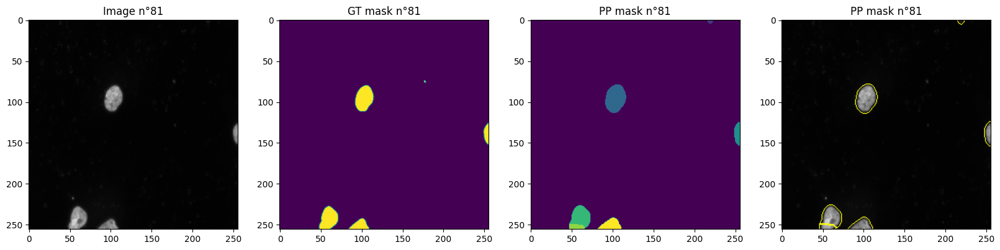

Number of true objects: 22
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	20	1	2	0.870
0.550	20	1	2	0.870
0.600	20	1	2	0.870
0.650	19	2	3	0.792
0.700	19	2	3	0.792
0.750	19	2	3	0.792
0.800	18	3	4	0.720
0.850	17	4	5	0.654
0.900	16	5	6	0.593
0.950	7	14	15	0.194
AP	-	-	-	0.714


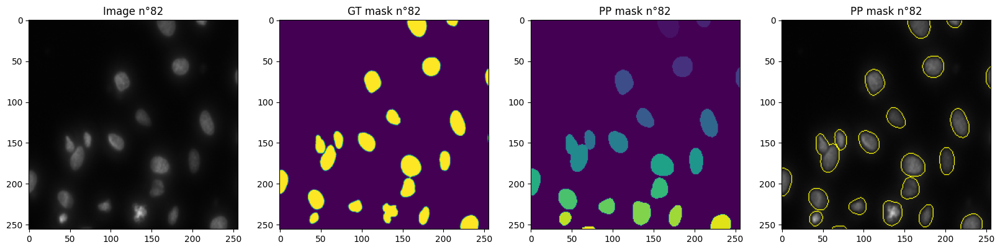

Number of true objects: 4
Number of predicted objects: 5
Thresh	TP	FP	FN	Prec.
0.500	4	1	0	0.800
0.550	4	1	0	0.800
0.600	4	1	0	0.800
0.650	4	1	0	0.800
0.700	4	1	0	0.800
0.750	4	1	0	0.800
0.800	4	1	0	0.800
0.850	4	1	0	0.800
0.900	3	2	1	0.500
0.950	1	4	3	0.125
AP	-	-	-	0.703


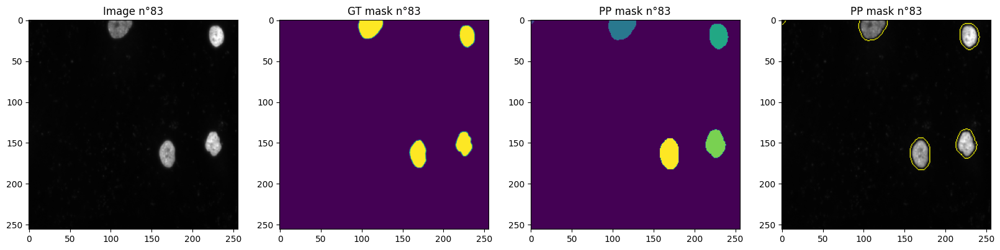

Number of true objects: 24
Number of predicted objects: 20
Thresh	TP	FP	FN	Prec.
0.500	20	0	4	0.833
0.550	20	0	4	0.833
0.600	20	0	4	0.833
0.650	20	0	4	0.833
0.700	20	0	4	0.833
0.750	20	0	4	0.833
0.800	19	1	5	0.760
0.850	18	2	6	0.692
0.900	16	4	8	0.571
0.950	11	9	13	0.333
AP	-	-	-	0.736


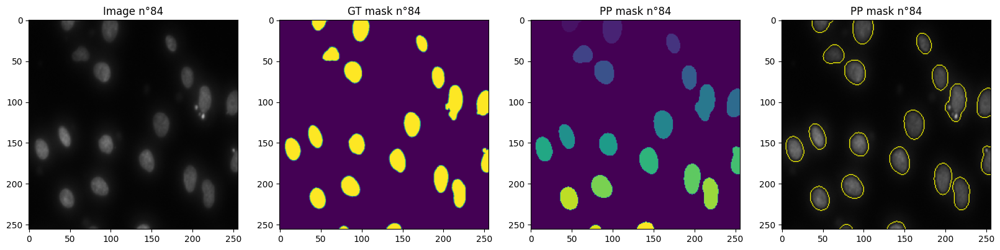

Number of true objects: 3
Number of predicted objects: 2
Thresh	TP	FP	FN	Prec.
0.500	2	0	1	0.667
0.550	2	0	1	0.667
0.600	2	0	1	0.667
0.650	2	0	1	0.667
0.700	2	0	1	0.667
0.750	2	0	1	0.667
0.800	2	0	1	0.667
0.850	2	0	1	0.667
0.900	0	2	3	0.000
0.950	0	2	3	0.000
AP	-	-	-	0.533


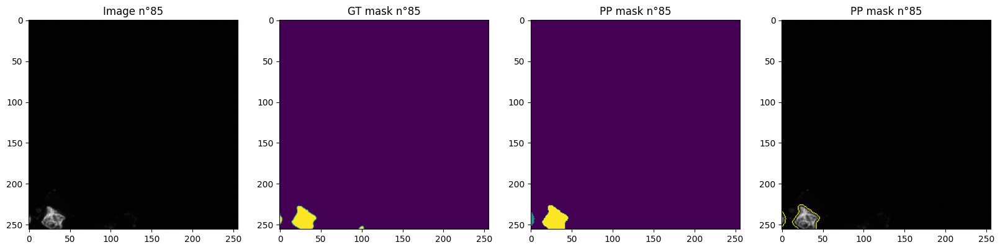

Number of true objects: 4
Number of predicted objects: 5
Thresh	TP	FP	FN	Prec.
0.500	4	1	0	0.800
0.550	4	1	0	0.800
0.600	3	2	1	0.500
0.650	3	2	1	0.500
0.700	3	2	1	0.500
0.750	3	2	1	0.500
0.800	2	3	2	0.286
0.850	2	3	2	0.286
0.900	1	4	3	0.125
0.950	0	5	4	0.000
AP	-	-	-	0.430


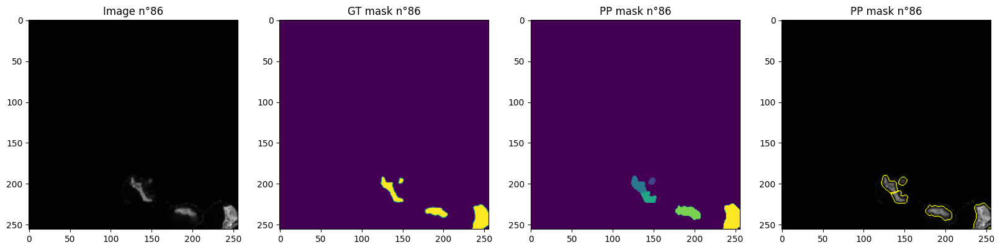

Number of true objects: 26
Number of predicted objects: 23
Thresh	TP	FP	FN	Prec.
0.500	20	3	6	0.690
0.550	18	5	8	0.581
0.600	17	6	9	0.531
0.650	17	6	9	0.531
0.700	17	6	9	0.531
0.750	17	6	9	0.531
0.800	15	8	11	0.441
0.850	6	17	20	0.140
0.900	2	21	24	0.043
0.950	0	23	26	0.000
AP	-	-	-	0.402


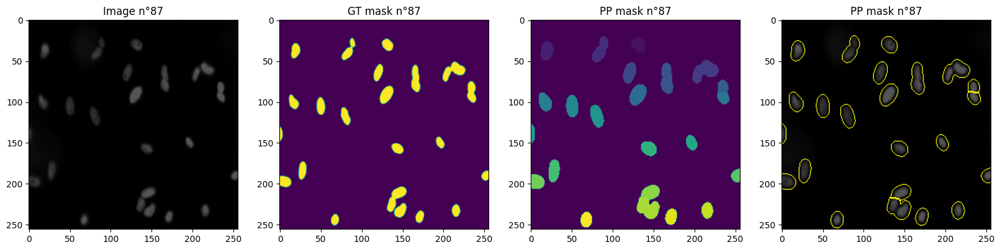

Number of true objects: 94
Number of predicted objects: 62
Thresh	TP	FP	FN	Prec.
0.500	55	7	39	0.545
0.550	51	11	43	0.486
0.600	46	16	48	0.418
0.650	45	17	49	0.405
0.700	42	20	52	0.368
0.750	39	23	55	0.333
0.800	34	28	60	0.279
0.850	27	35	67	0.209
0.900	8	54	86	0.054
0.950	0	62	94	0.000
AP	-	-	-	0.310


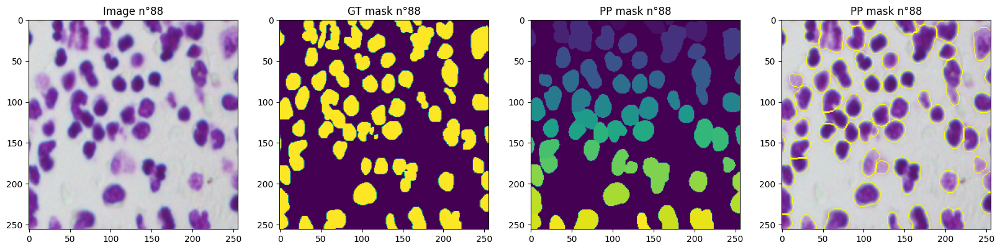

Number of true objects: 4
Number of predicted objects: 3
Thresh	TP	FP	FN	Prec.
0.500	3	0	1	0.750
0.550	3	0	1	0.750
0.600	2	1	2	0.400
0.650	2	1	2	0.400
0.700	2	1	2	0.400
0.750	2	1	2	0.400
0.800	2	1	2	0.400
0.850	2	1	2	0.400
0.900	1	2	3	0.167
0.950	0	3	4	0.000
AP	-	-	-	0.407


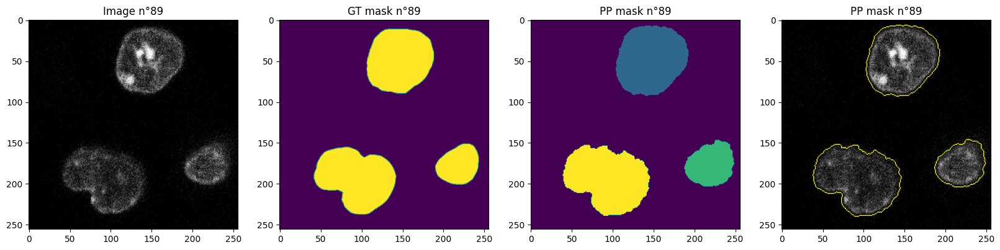

Number of true objects: 40
Number of predicted objects: 34
Thresh	TP	FP	FN	Prec.
0.500	30	4	10	0.682
0.550	30	4	10	0.682
0.600	29	5	11	0.644
0.650	28	6	12	0.609
0.700	27	7	13	0.574
0.750	27	7	13	0.574
0.800	26	8	14	0.542
0.850	24	10	16	0.480
0.900	17	17	23	0.298
0.950	6	28	34	0.088
AP	-	-	-	0.517


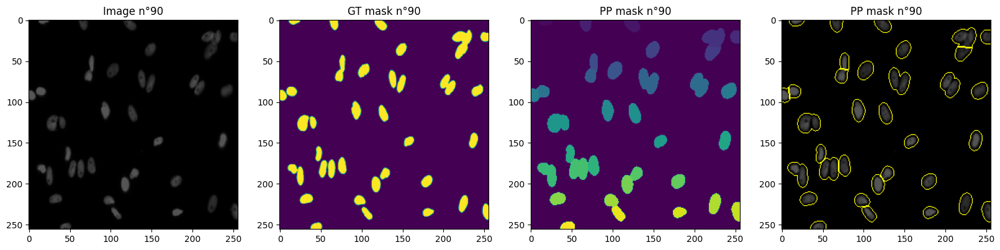

Number of true objects: 164
Number of predicted objects: 105
Thresh	TP	FP	FN	Prec.
0.500	64	41	100	0.312
0.550	57	48	107	0.269
0.600	52	53	112	0.240
0.650	46	59	118	0.206
0.700	45	60	119	0.201
0.750	37	68	127	0.159
0.800	23	82	141	0.093
0.850	10	95	154	0.039
0.900	1	104	163	0.004
0.950	0	105	164	0.000
AP	-	-	-	0.152


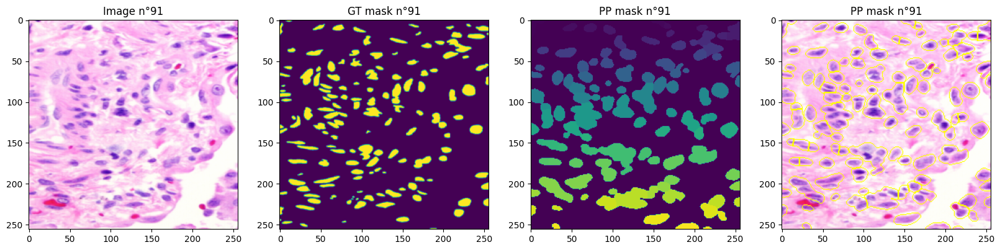

Number of true objects: 29
Number of predicted objects: 22
Thresh	TP	FP	FN	Prec.
0.500	21	1	8	0.700
0.550	19	3	10	0.594
0.600	18	4	11	0.545
0.650	18	4	11	0.545
0.700	18	4	11	0.545
0.750	18	4	11	0.545
0.800	18	4	11	0.545
0.850	18	4	11	0.545
0.900	17	5	12	0.500
0.950	8	14	21	0.186
AP	-	-	-	0.525


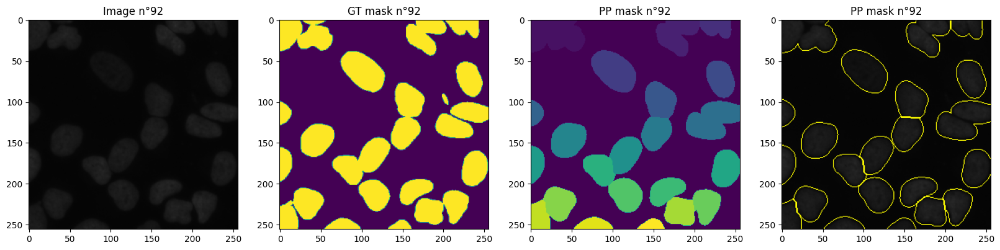

Number of true objects: 3
Number of predicted objects: 2
Thresh	TP	FP	FN	Prec.
0.500	2	0	1	0.667
0.550	2	0	1	0.667
0.600	2	0	1	0.667
0.650	2	0	1	0.667
0.700	1	1	2	0.250
0.750	1	1	2	0.250
0.800	1	1	2	0.250
0.850	1	1	2	0.250
0.900	1	1	2	0.250
0.950	0	2	3	0.000
AP	-	-	-	0.392


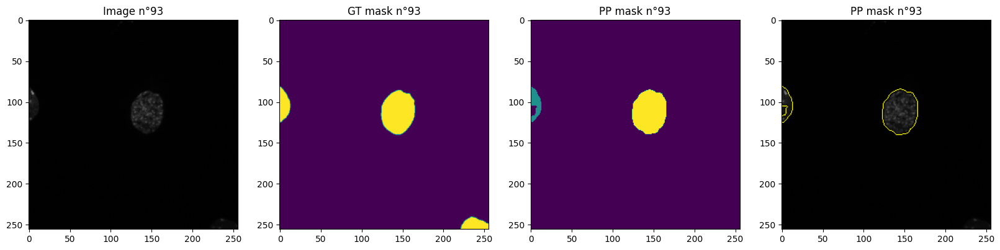

Number of true objects: 28
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	21	0	7	0.750
0.550	21	0	7	0.750
0.600	21	0	7	0.750
0.650	21	0	7	0.750
0.700	21	0	7	0.750
0.750	21	0	7	0.750
0.800	21	0	7	0.750
0.850	20	1	8	0.690
0.900	18	3	10	0.581
0.950	8	13	20	0.195
AP	-	-	-	0.672


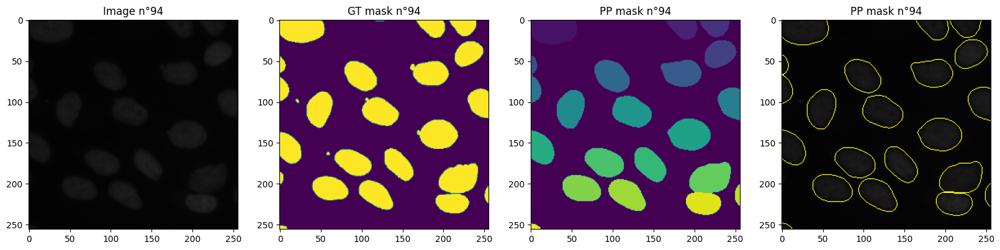

Number of true objects: 8
Number of predicted objects: 8
Thresh	TP	FP	FN	Prec.
0.500	8	0	0	1.000
0.550	8	0	0	1.000
0.600	8	0	0	1.000
0.650	8	0	0	1.000
0.700	8	0	0	1.000
0.750	8	0	0	1.000
0.800	8	0	0	1.000
0.850	8	0	0	1.000
0.900	7	1	1	0.778
0.950	3	5	5	0.231
AP	-	-	-	0.901


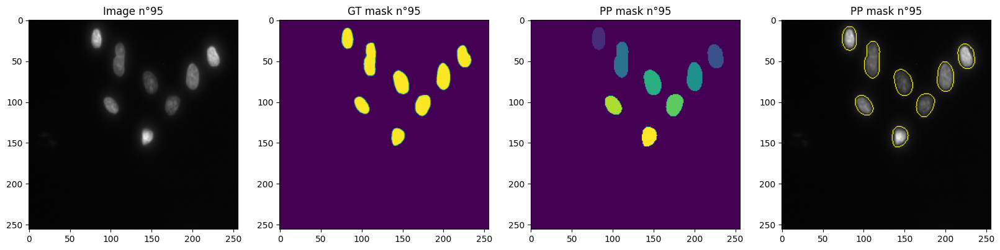

Number of true objects: 93
Number of predicted objects: 41
Thresh	TP	FP	FN	Prec.
0.500	31	10	62	0.301
0.550	27	14	66	0.252
0.600	27	14	66	0.252
0.650	25	16	68	0.229
0.700	22	19	71	0.196
0.750	17	24	76	0.145
0.800	11	30	82	0.089
0.850	3	38	90	0.023
0.900	1	40	92	0.008
0.950	0	41	93	0.000
AP	-	-	-	0.150


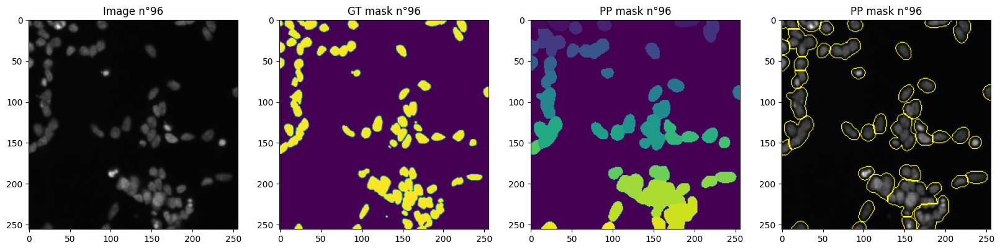

Number of true objects: 74
Number of predicted objects: 53
Thresh	TP	FP	FN	Prec.
0.500	45	8	29	0.549
0.550	45	8	29	0.549
0.600	45	8	29	0.549
0.650	42	11	32	0.494
0.700	40	13	34	0.460
0.750	40	13	34	0.460
0.800	40	13	34	0.460
0.850	39	14	35	0.443
0.900	23	30	51	0.221
0.950	4	49	70	0.033
AP	-	-	-	0.422


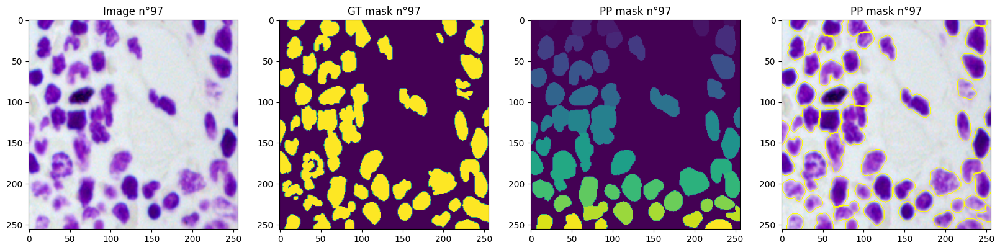

Number of true objects: 1
Number of predicted objects: 1
Thresh	TP	FP	FN	Prec.
0.500	1	0	0	1.000
0.550	1	0	0	1.000
0.600	1	0	0	1.000
0.650	1	0	0	1.000
0.700	1	0	0	1.000
0.750	1	0	0	1.000
0.800	1	0	0	1.000
0.850	1	0	0	1.000
0.900	1	0	0	1.000
0.950	0	1	1	0.000
AP	-	-	-	0.900


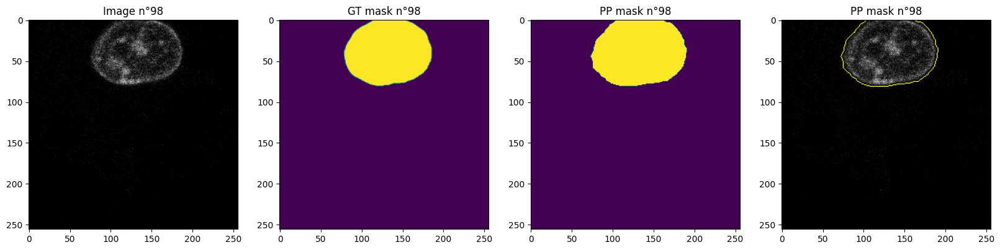

Number of true objects: 123
Number of predicted objects: 37
Thresh	TP	FP	FN	Prec.
0.500	18	19	105	0.127
0.550	15	22	108	0.103
0.600	12	25	111	0.081
0.650	10	27	113	0.067
0.700	9	28	114	0.060
0.750	6	31	117	0.039
0.800	2	35	121	0.013
0.850	1	36	122	0.006
0.900	0	37	123	0.000
0.950	0	37	123	0.000
AP	-	-	-	0.050


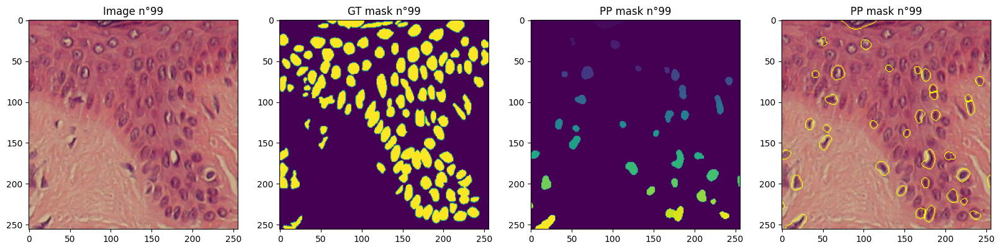

Number of true objects: 11
Number of predicted objects: 12
Thresh	TP	FP	FN	Prec.
0.500	11	1	0	0.917
0.550	11	1	0	0.917
0.600	11	1	0	0.917
0.650	10	2	1	0.769
0.700	10	2	1	0.769
0.750	9	3	2	0.643
0.800	9	3	2	0.643
0.850	9	3	2	0.643
0.900	8	4	3	0.533
0.950	0	12	11	0.000
AP	-	-	-	0.675


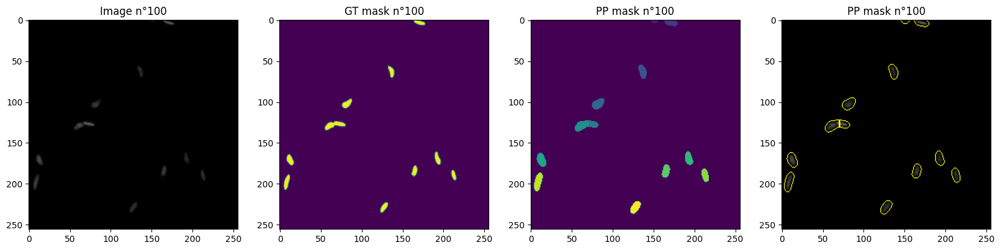

Number of true objects: 25
Number of predicted objects: 23
Thresh	TP	FP	FN	Prec.
0.500	21	2	4	0.778
0.550	21	2	4	0.778
0.600	21	2	4	0.778
0.650	21	2	4	0.778
0.700	21	2	4	0.778
0.750	21	2	4	0.778
0.800	21	2	4	0.778
0.850	21	2	4	0.778
0.900	18	5	7	0.600
0.950	9	14	16	0.231
AP	-	-	-	0.705


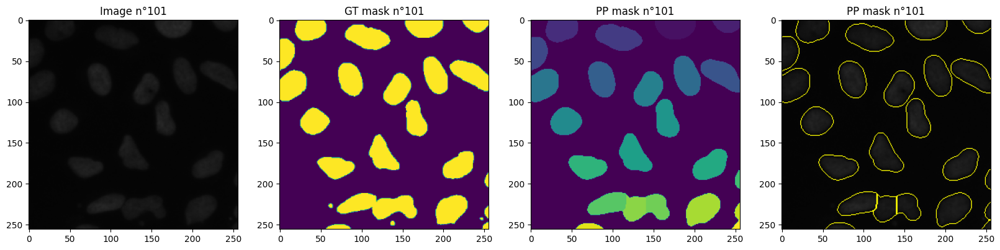

Number of true objects: 78
Number of predicted objects: 73
Thresh	TP	FP	FN	Prec.
0.500	58	15	20	0.624
0.550	55	18	23	0.573
0.600	52	21	26	0.525
0.650	44	29	34	0.411
0.700	31	42	47	0.258
0.750	18	55	60	0.135
0.800	9	64	69	0.063
0.850	2	71	76	0.013
0.900	1	72	77	0.007
0.950	0	73	78	0.000
AP	-	-	-	0.261


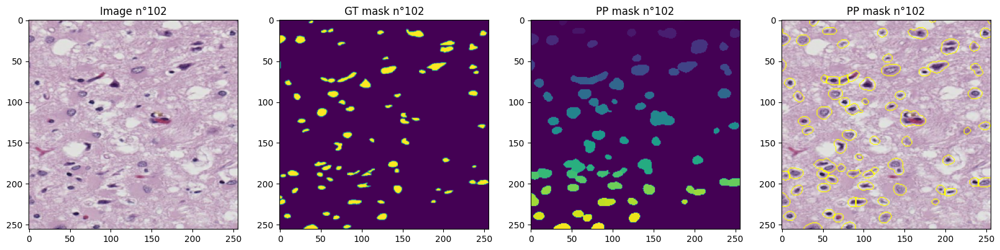

Number of true objects: 246
Number of predicted objects: 38
Thresh	TP	FP	FN	Prec.
0.500	17	21	229	0.064
0.550	15	23	231	0.056
0.600	15	23	231	0.056
0.650	13	25	233	0.048
0.700	12	26	234	0.044
0.750	11	27	235	0.040
0.800	11	27	235	0.040
0.850	10	28	236	0.036
0.900	9	29	237	0.033
0.950	1	37	245	0.004
AP	-	-	-	0.042


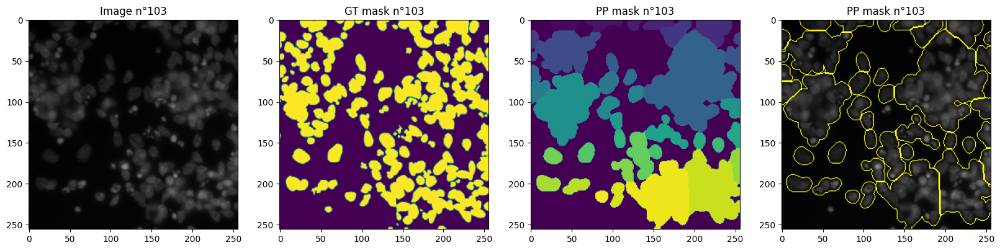

Number of true objects: 54
Number of predicted objects: 52
Thresh	TP	FP	FN	Prec.
0.500	43	9	11	0.683
0.550	40	12	14	0.606
0.600	38	14	16	0.559
0.650	38	14	16	0.559
0.700	37	15	17	0.536
0.750	31	21	23	0.413
0.800	27	25	27	0.342
0.850	20	32	34	0.233
0.900	13	39	41	0.140
0.950	0	52	54	0.000
AP	-	-	-	0.407


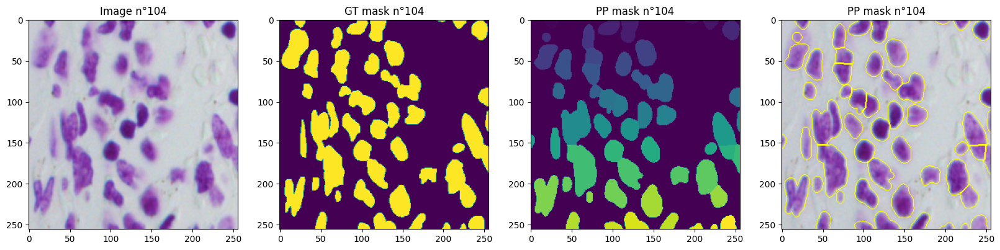

Number of true objects: 83
Number of predicted objects: 58
Thresh	TP	FP	FN	Prec.
0.500	48	10	35	0.516
0.550	46	12	37	0.484
0.600	43	15	40	0.439
0.650	40	18	43	0.396
0.700	38	20	45	0.369
0.750	36	22	47	0.343
0.800	32	26	51	0.294
0.850	27	31	56	0.237
0.900	14	44	69	0.110
0.950	1	57	82	0.007
AP	-	-	-	0.319


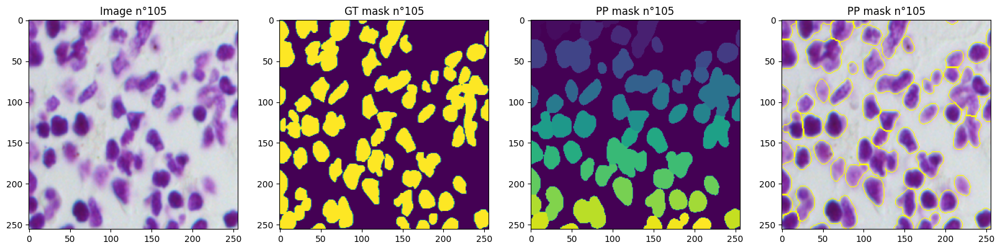

LB = 0.5186002740087619


In [ ]:
# import csv
# import os

# Prediction
# test_1_pp_masks = post_proccess_masks(test_1_pred_masks)
test_2_pp_masks = post_proccess_masks(test_2_pred_masks)



# Results
# show_results(test_1_images, test_1_masks, test_1_labels, test_1_pred_masks, test_1_pp_masks, verbose=False)
show_results(test_2_images, test_2_masks, test_2_labels, test_2_pred_masks, test_2_pp_masks, verbose=True)

# # Run-length encoding taken from https://www.kaggle.com/rakhlin/fast-run-length-encoding-python
# def rle_encoding(y):
#     dots = np.where(y.T.flatten() == 1)[0]
#     run_lengths = []
#     prev = -2
#     for b in dots:
#         if (b>prev+1): run_lengths.extend((b + 1, 0))
#         run_lengths[-1] += 1
#         prev = b
#     return run_lengths

# def pred_to_rles(y):
#     for i in range(1, y.max() + 1):
#         yield rle_encoding(y == i)


# def submit_data(uuids, preds, original_shapes):
#     with open(SUBMISSION_PATH, 'w', newline='') as csvfile:
#         writer = csv.writer(csvfile)
#         writer.writerow(['ImageId', 'EncodedPixels'])

#         for idx, (uid, y) in tqdm(enumerate(zip(uuids, preds))):
#             uid = os.path.basename(uid)
#             y = label(erosion(y, footprint=disk(2)))
#             y_resized = resize(y, (original_shapes[idx][0], original_shapes[idx][1]), mode='constant', order=0, preserve_range=True, anti_aliasing=True)
#             for rle in pred_to_rles(y_resized):
#                 writer.writerow([uid, ' '.join([str(i) for i in rle])])



# submit_data(test_2_ids, test_2_pp_masks, test_2_shapes)

# !kaggle competitions submit -c data-science-bowl-2018 -f "{SUBMISSION_PATH}" -m "Message"
# !kaggle competitions submissions -c data-science-bowl-2018

In [ ]:
import pandas as pd

def submission():
    # Read the CSV file into a DataFrame
    df = pd.read_csv(STAGE_2_SOLUTION_PATH)

    # List of columns to remove
    columns_to_remove = ['Height', 'Width', 'Usage']

    # Remove the specified columns
    df = df.drop(columns=columns_to_remove)

    # Remove rows where 'encodedPixels' column has the value '1 1'
    df = df[df['EncodedPixels'] != '1 1']

    # Write the modified DataFrame back to a CSV file
    df.to_csv(SOLUTION_PATH, index=False)

In [ ]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

# Then move kaggle.json into the folder where the API expects to find it.
!mkdir -p ~/.kaggle/ && mv kaggle.json ~/.kaggle/ && chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json
User uploaded file "kaggle.json" with length 64 bytes


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import interact, IntSlider
from IPython.display import display

def read_mask_from_csv(test_2_images, test_2_shapes, test_2_pp_masks):
    df1 = pd.read_csv(STAGE_2_SOLUTION_PATH)
    df2 = pd.read_csv(SUBMISSION_PATH)

    image_ids = sorted(list(df1['ImageId'].unique()))

    @interact(idx1=IntSlider(min=0, max=len(image_ids)-1, step=1, value=0, description='Image Index'))
    def plot_masks(idx1):
        image_id = image_ids[idx1]
        mask_rles_1 = df1.loc[df1['ImageId'] == image_id, 'EncodedPixels']
        mask_rles_2 = df2.loc[df2['ImageId'] == image_id, 'EncodedPixels']

        masks_1 = rle_decode(rle_list=mask_rles_1, mask_shape=(test_2_shapes[idx1][0], test_2_shapes[idx1][1]), mask_dtype=np.uint16)
        masks_2 = rle_decode(rle_list=mask_rles_2, mask_shape=(test_2_shapes[idx1][0], test_2_shapes[idx1][1]), mask_dtype=np.uint16)

        @interact(idx2=IntSlider(min=0, max=len(masks_1)-1, step=1, value=0, description='Masks 1 Index'),
                  idx3=IntSlider(min=0, max=len(masks_2)-1, step=1, value=0, description='Masks 2 Index'))
        def plot_individual_masks(idx2, idx3):
            fig, axes = plt.subplots(1, 4, figsize=(15, 5))
            axes[0].imshow(resize(test_2_images[idx1], (test_2_shapes[idx1][0], test_2_shapes[idx1][1])))
            axes[0].set_title('Image from stage 2')

            axes[1].imshow(np.logical_or.reduce(masks_1))
            axes[1].set_title('Mask from STAGE_2_SOLUTION_PATH')

            axes[2].imshow(np.logical_or.reduce(masks_2))
            axes[2].set_title('Mask from SUBMISSION_PATH')

            y = resize(test_2_pp_masks[idx1], (test_2_shapes[idx1][0], test_2_shapes[idx1][1]), order=0, mode='constant', preserve_range='True')
            print(np.unique(y))
            axes[3].imshow(y)
            axes[3].set_title('PP mask')

            plt.show()

read_mask_from_csv(test_2_images, test_2_shapes, test_2_pp_masks)


interactive(children=(IntSlider(value=0, description='Image Index', max=105), Output()), _dom_classes=('widget…

interactive(children=(IntSlider(value=0, continuous_update=False, description='Image Index:', max=587), Output…

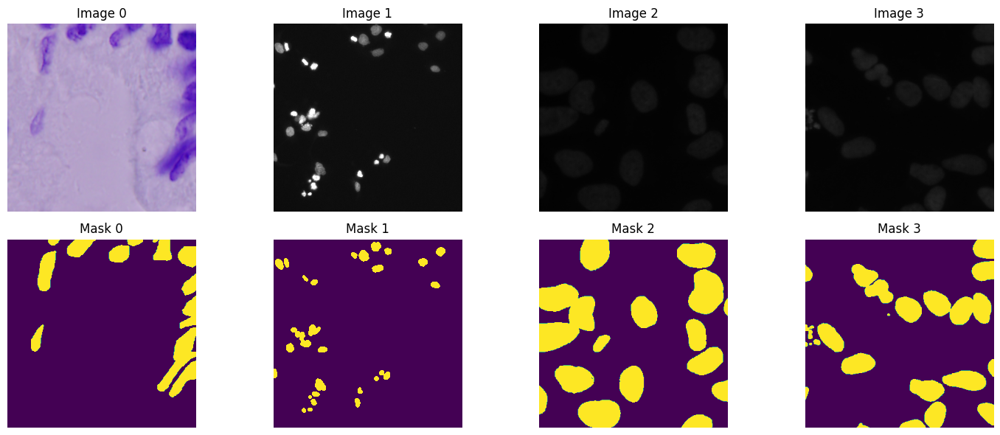

In [ ]:
import matplotlib.pyplot as plt
import ipywidgets as widgets

def plot_some_images(train_images, train_masks):
    num_images = min(len(train_images), len(train_masks))
    num_rows = 2
    num_cols = 4

    # Create figure and axes
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 6))

    # Create index widget
    index_slider = widgets.IntSlider(value=0, min=0, max=num_images - 1, description='Image Index:', continuous_update=False)

    def update_plot(index):
        # Clear previous plots
        for ax in axes.flatten():
            ax.clear()

        # Plot images and masks
        for i in range(num_cols):
            if index + i < num_images:
                axes[0, i].imshow(train_images[index + i])
                axes[0, i].set_title(f"Image {index + i}")
                axes[0, i].axis('off')

                axes[1, i].imshow(train_masks[index + i])
                axes[1, i].set_title(f"Mask {index + i}")
                axes[1, i].axis('off')

    # Connect widget to update function
    widgets.interact(update_plot, index=index_slider)

    plt.tight_layout()
    plt.show()

plot_some_images(train_images, train_masks)

Number of true objects: 34
Number of predicted objects: 34
Thresh	TP	FP	FN	Prec.
0.500	33	1	1	0.943
0.550	32	2	2	0.889
0.600	30	4	4	0.789
0.650	29	5	5	0.744
0.700	26	8	8	0.619
0.750	13	21	21	0.236
0.800	9	25	25	0.153
0.850	0	34	34	0.000
0.900	0	34	34	0.000
0.950	0	34	34	0.000
AP	-	-	-	0.437


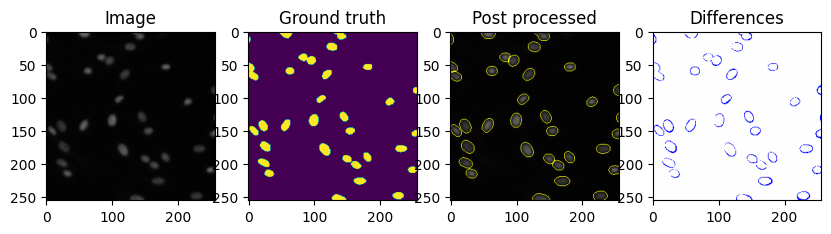

In [ ]:
from matplotlib.colors import LinearSegmentedColormap

def show_results_1(images, gt_masks, labels, pred_masks, pp_masks, verbose=True):
    fig, ax = plt.subplots(1, 4, figsize=(10, 10))
    idx = 1

    colors = [(0, 0, 1), (1, 1, 1), (1, 0, 0)]  # (blue, red)
    cmap_name = 'custom_cmap'
    cm = LinearSegmentedColormap.from_list(cmap_name, colors)

    ax[0].set_title(f'Image')
    ax[0].imshow(images[76])
    ax[1].set_title(f'Ground truth')
    ax[1].imshow(gt_masks[76])
    ax[2].set_title(f'Post processed')
    ax[2].imshow(mark_boundaries(images[76], pp_masks[76]))
    ax[3].set_title(f'Differences')
    a = np.squeeze(gt_masks[76]) - (pp_masks[76] > 0).astype(np.uint8)
    ax[3].imshow(a, cmap=cm, vmin=-1, vmax=1)

    a = labels[76]
    b = label(pp_masks[76])
    score_i = score(a, b, verbose=verbose)

    # ax[1, 0].imshow(images[15])
    # ax[1, 1].imshow(gt_masks[15])
    # ax[1, 2].imshow(mark_boundaries(images[15], pp_masks[15]))
    # b = np.squeeze(gt_masks[15]) - (pp_masks[15] > 0).astype(np.uint8)
    # ax[1, 3].imshow(b, cmap=cm, vmin=-1, vmax=1)

    # ax[2, 0].imshow(images[32])
    # ax[2, 1].imshow(gt_masks[32])
    # ax[2, 2].imshow(mark_boundaries(images[32], pp_masks[32]))
    # c = np.squeeze(gt_masks[32]) - (pp_masks[32] > 0).astype(np.uint8)
    # ax[2, 3].imshow(c, cmap=cm, vmin=-1, vmax=1)

    # ax[3, 0].imshow(images[88])
    # ax[3, 1].imshow(gt_masks[88])
    # ax[3, 2].imshow(mark_boundaries(images[88], pp_masks[88]))
    # d = np.squeeze(gt_masks[88]) - (pp_masks[88] > 0).astype(np.uint8)
    # ax[3, 3].imshow(d, cmap=cm, vmin=-1, vmax=1)

    plt.show()

show_results_1(test_2_images, test_2_masks, test_2_labels, test_2_pred_masks, test_2_pp_masks, verbose=True)